In [2]:
from IPython.display import Image as pdImage
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec
import glob
from matplotlib import rc
rc('text', usetex=False)
rc('font', **{'family': 'serif', 'serif':['Computer Modern Roman']})
import json, os, shutil, itertools, fnmatch, re
from scipy.interpolate import griddata, make_interp_spline, BSpline
import scipy.misc
import tensorflow as tf
import cirq
import seaborn as sns
import sys
import copy
import re
import pickle as pkl
#from ..create_outputs import CreateOutputs
from PIL import Image, ImageDraw, ImageFont
from collections import defaultdict
from typing import Dict
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator
if sys.platform.startswith('win'):
    code_path = "C:\\Users\\Andrew Patterson\\Google Drive\\PhD\\First Year\\Untitled Folder\\cirq_state_discrimination"
else:
    code_path = "/home/zcapga1/Scratch/state_discrimination/code/"
sys.path.append(code_path)
sns.set_style('whitegrid')
sns.set_context('poster')
rc('text', usetex=False)
rc('font', **{'family': 'serif', 'serif':['Computer Modern Roman']})
image_direc = r'C:\Users\Andrew Patterson\Google Drive\PhD\First Year\State Discrimination Paper\poster\images'
print(tf.__version__)
print(cirq.__version__)

2.0.0
0.6.0


In [2]:
class SeabornFig2Grid():

    def __init__(self, seaborngrid, fig,  subplot_spec):
        self.fig = fig
        self.sg = seaborngrid
        self.subplot = subplot_spec
        if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
            isinstance(self.sg, sns.axisgrid.PairGrid):
            self._movegrid()
        elif isinstance(self.sg, sns.axisgrid.JointGrid):
            self._movejointgrid()
        self._finalize()

    def _movegrid(self):
        """ Move PairGrid or Facetgrid """
        self._resize()
        n = self.sg.axes.shape[0]
        m = self.sg.axes.shape[1]
        self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
        for i in range(n):
            for j in range(m):
                self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

    def _movejointgrid(self):
        """ Move Jointgrid """
        h= self.sg.ax_joint.get_position().height
        h2= self.sg.ax_marg_x.get_position().height
        r = int(np.round(h/h2))
        self._resize()
        self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

        self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
        self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
        self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

    def _moveaxes(self, ax, gs):
        #https://stackoverflow.com/a/46906599/4124317
        ax.remove()
        ax.figure=self.fig
        self.fig.axes.append(ax)
        self.fig.add_axes(ax)
        ax._subplotspec = gs
        ax.set_position(gs.get_position(self.fig))
        ax.set_subplotspec(gs)

    def _finalize(self):
        plt.close(self.sg.fig)
        self.fig.canvas.mpl_connect("resize_event", self._resize)
        self.fig.canvas.draw()

    def _resize(self, evt=None):
        self.sg.fig.set_size_inches(self.fig.get_size_inches())

In [3]:
def create_args(path: str) -> str:
    args = " --create_outputs --restore_loc=\"{}\" ".format(path)
    
    if re.search(r'tf', path):
        args = args + " --use_tf"
            
    with open(os.path.join(path, 'saved_params.json')) as f:
        params = json.load(f)

#     if params['mu_a'] == 0.5:
#         args = args + ' --file_loc=sigma005_mu05_bconst.json'
#     elif params['mu_a'] == 0.25:
#         args = args + ' --file_loc=sigma005_mu025_bconst.json'
#     else:
    args = args + ' --max_epoch=25 --batch_size=100'
    data_args = ['prop_a', 'b_const', 'a_const', 'mu_a', 'mu_b', 'sigma_a', 'sigma_b']
    for a in data_args:
        args = args + ' --{}={}'.format(a, str(params[a]))
            
    dicts = (params['gate_dict'], params['gate_dict_0'], params['gate_dict_1'])
    dict_path = os.path.join(path, 'temp_dicts.pkl')
    with open(dict_path, 'wb') as f:
        pkl.dump(dicts, f, pkl.HIGHEST_PROTOCOL)
    
    args = args + " --dicts=\"{}\"".format(dict_path)

    other_args = ['cost_error', 'cost_incon', 'no_qubits', 'noise_on', 
                  'noise_prob', 'learning_rate', 'beta1', 'beta2']
    for a in other_args:
        args = args + ' --{}={}'.format(a, str(params[a]))
    return args
            
def generate_output_file(directory: str) -> None:
    folder_list = [f for f in os.listdir(directory) if os.path.isdir(os.path.join(directory, f))]
    for restore_path in folder_list:
        full_path = os.path.join(directory, restore_path)
        if os.path.exists(os.path.join(full_path, 'saved_params.json')):
    
            args = create_args(full_path)

            run_file = os.path.join(code_path, 'run_training.py')
            os.system("python \"" + run_file +"\"" + args)
        

# noise_dir = r"C:\Users\Andrew Patterson\Desktop"
# path = "C:\\Users\\Andrew Patterson\\Documents\\PhD\\cirq_state_discrimination\\checkpoints\\myriad_data\\new_analysis\\tf_noise_array\\2019_08_01_21_50_31"
# if re.search("tf", path):
#     print('yes')
# args = ' --output_loc=\"{}\" '.format(noise_dir) + create_args(r"C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\new_analysis\tf_noise_array\2019_08_01_21_50_31")
# args

In [4]:
def label_plot(directory: str, create_new=False) -> None:
    folder_list = [f for f in os.listdir(directory) if os.path.isdir(os.path.join(directory, f))]
    for path in folder_list:
        param_path = os.path.join(directory, path, 'saved_params.json')
        plot_path = os.path.join(directory, path, 'outputs')
        if os.path.exists(param_path) and os.path.exists(os.path.join(plot_path, 'probs.npy')):
            if create_new:
                probs = np.load(os.path.join(plot_path, 'probs.npy'))
                CreateOutputs.create_bar_plot(plot_path, probs[0], probs[1])
            
            with open(param_path) as f:
                param_dict = json.load(f)
            
            probs = np.load(os.path.join(plot_path, 'probs.npy'))
            p_suc = np.average([probs[0][0], probs[1][1]])
            msg = u'Success_{:.2f}'.format(p_suc)

            param_list = ['cost_error', 'cost_incon', 'noise_prob', 'mu_a', 'sigma_a']
            if not param_dict['b_const']:
                param_list.extend(['mu_b', 'sigma_b'])

            if param_dict['noise_on'] == 'false' or param_dict['noise_on'] == 'False':
                param_list.remove('noise_prob')
                
            for i, param in enumerate(param_list):
                msg = msg + '_{}_{}'.format(param, param_dict[param])
#                 if (i + 1) % 2 == 0:
#                     msg = msg + "\n"
            msg = msg[:-2]
            msg = msg.replace('.', '-')
#             msg = msg.replace('mu ', '\u03bc')
#             msg = msg.replace('sigma ', '\u03c3')
            

            font_path = os.path.join(r"C:\Users\Andrew Patterson\Documents\PhD\fonts\fonts\ofl\computer-modern", 'cmunrm.ttf')
            font = ImageFont.truetype(font_path, size=13)
            plot = Image.open(os.path.join(plot_path, 'bar_graph.png'))

            width, height = plot.size
            cropped = plot.crop((60, 44, 422, 278))
            draw = ImageDraw.Draw(cropped)
            (x,y) = (5,5)
            colour = 'rgb(0, 0, 0)'
#             draw.text((x,y), msg, fill=colour, font=font)
            save_path = os.path.join(plot_path, 'plot_labeled.png')
            cropped.save(save_path)
            os.system("convert \"{}\" -fuzz 2% -transparent white \"{}\"".format(save_path, save_path))
            try:
                os.rename(os.path.join(directory, path), os.path.join(directory, str(param_dict['noise_prob']).replace('.', '-')))
            except FileExistsError:
                continue
        
direc = r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\noise_array'
folders = os.listdir(direc)
# folders = ['tf_noise_array_mu025_new', 'tf_noise_array_new']
# for f in folders:
#     path = os.path.join(direc, f)
#     label_plot(path)
# label_plot(r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\tf_old_2_60_sigma001_mu025_new', True)

In [5]:
def label_plot_val_levels(directory: str, create_new=False) -> None:
    folder_list = [f for f in os.listdir(directory) if os.path.isdir(os.path.join(directory, f))]
    for path in folder_list:
        param_path = os.path.join(directory, path, 'saved_params.json')
        if os.path.exists(param_path):
            
            with open(param_path) as f:
                param_dict = json.load(f)

            param_list = ['cost_error', 'cost_incon', 'noise_prob', 'mu_a', 'sigma_a']
            if not param_dict['b_const']:
                param_list.extend(['mu_b', 'sigma_b'])
            noise_levels = os.path.join(directory, path, 'outputs_with_noise_levels')
            levels = [f for f in os.listdir(noise_levels) if os.path.isdir(os.path.join(noise_levels, f))]
            for level in levels:
                probs = np.load(os.path.join(noise_levels, level, 'probs.npy'))
                if create_new:
                    CreateOutputs.create_bar_plot(os.path.join(noise_levels, level), probs[0], probs[1])
                
                p_suc = np.average([probs[0][0], probs[1][1]])
                msg = 'Success: {:.2f}, '.format(p_suc)
                for i, param in enumerate(param_list):
                    msg = msg + '{}: {}, '.format(param, param_dict[param])
                    if (i + 1) % 2 == 0:
                        msg = msg + "\n"
                msg = msg.replace('noise_prob', 'training_noise_prob')
                msg = msg + 'validation_noise_prob : {} '.format(level.replace('_', '.'))
                msg = msg.replace('_', ' ')
                msg = msg.replace('mu ', '\u03bc')
                msg = msg.replace('sigma ', '\u03c3')
                

                font_path = r"C:\Users\Andrew Patterson\Documents\PhD\fonts\fonts\ofl\computer-modern\cmunrm.ttf"
                font = ImageFont.truetype(font_path, size=13)
                plot = Image.open(os.path.join(noise_levels, level, 'bar_graph.png'))

                width, height = plot.size
                cropped = plot.crop((60, 44, 422, 278))
                draw = ImageDraw.Draw(cropped)
                (x,y) = (5,5)
                colour = 'rgb(0, 0, 0)'
#                 draw.text((x,y), msg, fill=colour, font=font)
                save_path = os.path.join(noise_levels, level, 'plot_labeled.png')
                cropped.save(save_path)
                os.system("convert \"{}\" -fuzz 1% -transparent white \"{}\"".format(save_path, save_path))

direc = r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\noise_array'
folders = os.listdir(direc)
# for f in folders:
#     path = os.path.join(direc, f)
#     label_plot_val_levels(path)

In [6]:
def nwise(iterable, n):
    ts = itertools.tee(iterable, n)
    for c, t in enumerate(ts):
        next(itertools.islice(t, c, c), None)
    return zip(*ts)

def moving_average(iterable, n):
    yield from (sum(x)/n for x in nwise(iterable, n))
    
def plot_loss_fn(folder, n=6, cutoff=100000):
    """
    Input: Takes a list of folders where models are strored and returns a graph of convergences plotted together
    """
    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    ax.set_xlabel('Step')
    ax.set_ylabel('Loss')
    ax.set_title('Training loss, Moving average = {}'.format(n))
    files = [f for f in os.listdir(folder) if os.path.isfile(os.path.join(folder, f))]
    event_file = fnmatch.filter(files, 'events*')
    steps = []
    loss = []
    for e in tf.compat.v1.train.summary_iterator(os.path.join(folder, event_file[0])):
        for v in e.summary.value:
            if v.tag == 'Training loss':
                if e.step <= cutoff:
                    steps.append(e.step)
                    val = np.frombuffer(v.tensor.tensor_content, dtype=np.float32)[0]
                    loss.append(val)

    param_file = os.path.join(folder, 'saved_params.json')
    with open(param_file, 'r') as f:
        params = json.load(f)
    if params['noise_on'] == "False":
        noise_level = 0
    else:
        noise_level = params['noise_prob']
    tot_cost = float(params['cost_error']) + float(params['cost_incon'])
    loss = np.array(loss)
    loss = loss / tot_cost
    np.save(os.path.join(folder, 'outputs', 'loss_fn.npy'), (steps, loss))
    loss_ma = moving_average(loss, n)
    step_ma = moving_average(steps, n)
    ax.plot(list(step_ma), list(loss_ma), label=noise_level)
    ax.legend()
    plt.savefig(os.path.join(folder, 'outputs', 'loss_fn.png'))

def save_loss_fns(directory: str):
    folder_list = [f for f in os.listdir(directory) if os.path.isdir(os.path.join(directory, f))]
    for path in folder_list:
        if os.path.exists(os.path.join(directory, path, 'saved_params.json')):
            plot_loss_fn(os.path.join(directory, path))
# save_loss_fns(r"C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\tf_noise_off_g")

In [7]:
def create_data_frame(directory: str):
    df = pd.DataFrame()
    folder_list = [f for f in os.listdir(directory) if os.path.isdir(os.path.join(directory, f))]
    for f in folder_list:
        path = os.path.join(directory, f)
        probs_path = os.path.join(path, 'outputs', 'probs.npy')
        if os.path.isfile(probs_path):
            with open(os.path.join(path, 'saved_params.json')) as js:
                params = json.load(js)
            probs = np.load(probs_path)

            p_error = np.average([probs[0][1], probs[1][0]])
            p_inc = np.average([probs[0][2], probs[1][2]])
            p_suc = np.average([probs[0][0], probs[1][1]])

            loss = p_error + p_inc

            df = df.append({'P_err': p_error, 'P_inc': p_inc, 'P_suc': p_suc, 'cost_err': params['cost_error'],
                            'cost_inc': params['cost_incon'], 'noise_on': params['noise_on'],
                            'noise_prob': params['noise_prob'], 'learning_rate': params['learning_rate'],
                            'loss': loss, 'folder': str(f)},
                           ignore_index=True)


    numeric = ['cost_err', 'cost_inc', 'noise_prob', 'learning_rate']
    df[numeric] = df[numeric].apply(pd.to_numeric, errors='coerce', axis=1)
    if not os.path.exists(os.path.join(directory, 'output')):
        os.mkdir(os.path.join(directory, 'output'))
    df.to_pickle(os.path.join(directory, 'output', 'dataframe.pkl'))
    f, ax = plt.subplots(figsize=(7,7))
    ax.set(xscale='log')
    df.plot(x='noise_prob', y='loss', ax=ax, style='k--')
    ax.set_xlabel('Noise level', fontsize=18)
    ax.set_ylabel('Loss', fontsize=18)
    plt.savefig(os.path.join(directory, 'output', 'loss_noise.png'))
    return df

In [12]:
# df = create_data_frame(r"C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\tf_noise_array_g")
# f, ax = plt.subplots(figsize=(7,7))
# ax.set(xscale='log', title='Loss with log noise')
# df.plot(x='noise_prob', y='loss', ax=ax, style='k--')

In [8]:
def pre_trained_new_noise_level(restore_directory: str, noise_levels: list):
    noise_levels_path = os.path.join(restore_directory, 'outputs_with_noise_levels')
    if not os.path.exists(noise_levels_path):
        os.mkdir(noise_levels_path)
        
    for noise in noise_levels:
        args_str = create_args(restore_directory)
        args_str = re.sub('(--noise_prob=\d*.\d*)', "--noise_prob={}".format(noise), args_str)
        args_str = re.sub('(--noise_on=\w*|\"\w*\")', "--noise_on=True", args_str)
        
        noise_dir = os.path.join(noise_levels_path, re.sub('\.', '_', str(noise)))
        args_str = args_str + ' --output_loc=\"{}\"'.format(noise_dir)
        run_file = os.path.join(code_path, 'run_training.py')
        os.system("python \"" + run_file +"\"" + args_str)
        
def pre_trained_multiple(directory: str, noise_levels: list):
    folder_list = [f for f in os.listdir(directory) if os.path.isdir(os.path.join(directory, f))]
    for path in folder_list:
        # if (not os.path.exists(os.path.join(directory, path, 'outputs_with_noise_levels'))) and os.path.exists(os.path.join(directory, path, 'saved_params.json')):
        if os.path.exists(os.path.join(directory, path, 'saved_params.json')):
            pre_trained_new_noise_level(os.path.join(directory, path), noise_levels)

noise_levels = [0.0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.25]        
# pre_trained_multiple(r"C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\tf_noise_off_g", True, noise_levels)
# pre_trained_multiple(r"C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\tf_noise_array", noise_levels)

In [9]:
deep=["#4C72B0", "#55A868", "#C44E52",
      "#8172B2", "#CCB974", "#64B5CD"]
muted=["#4878CF", "#6ACC65", "#D65F5F",
       "#B47CC7", "#C4AD66", "#77BEDB"]
pastel=["#92C6FF", "#97F0AA", "#FF9F9A",
        "#D0BBFF", "#FFFEA3", "#B0E0E6"]
bright=["#003FFF", "#03ED3A", "#E8000B",
        "#8A2BE2", "#FFC400", "#00D7FF"]
dark=["#001C7F", "#017517", "#8C0900",
      "#7600A1", "#B8860B", "#006374"]
colorblind=["#0072B2", "#009E73", "#D55E00",
            "#CC79A7", "#F0E442", "#56B4E9"]
pal = dark
noise_pal = {0.0: pal[0], 0.0001: pal[1], 0.0005: pal[2], 0.001: pal[3], 0.005: pal[4],  0.01: pal[5], 0.05: pal[0], 0.1: pal[1], 0.25:pal[2]}

def read_angles_probs(path: str, params: Dict, training_noise: float, df: pd.DataFrame, p: str):
        probs = np.load(os.path.join(path, 'probs.npy'))
        
        p_error = np.average([probs[0][1], probs[1][0]])
        p_inc = np.average([probs[0][2], probs[1][2]])
        p_suc = np.average([probs[0][0], probs[1][1]])
        
        a_a = probs[0][0]
        a_b = probs[0][1]
        a_inc = probs[0][2]
        
        b_a = probs[1][0]
        b_b = probs[1][1]
        b_inc = probs[1][2]

        loss = p_error + p_inc
        
        angles = np.load(os.path.join(path, 'final_angles.npy'))
            
        df = df.append({'P_err': p_error, 'P_inc': p_inc, 'cost_err': params['cost_error'],
                        'cost_inc': params['cost_incon'], 'mu_a': params['mu_a'], 'sigma_a': params['sigma_a'], 'training_noise': training_noise, 
                        'noise_prob': re.sub('\_', '.', p), 'loss': loss, 'angles': angles, 'a_a': a_a, 'a_b': a_b, 
                       'a_inc': a_inc, 'b_a': b_a, 'b_b': b_b, 'b_inc': b_inc, 'path': path},
                       ignore_index=True)
        return df

def create_noise_levels_df(directory: str) -> pd.DataFrame:
    df = pd.DataFrame()
    params_path = os.path.join(directory, 'saved_params.json')
    with open(params_path) as js:
        params = json.load(js)
    noise_folder = os.path.join(directory, 'outputs_with_noise_levels')
    noise_paths = [f for f in os.listdir(noise_folder) if os.path.isdir(os.path.join(noise_folder, f))]
    
    if params['noise_on'] == 'True':
        training_noise = params['noise_prob']
    else:
        training_noise = 0
            
    for p in noise_paths:
        path = os.path.join(noise_folder, p)
        df = read_angles_probs(path, params, training_noise, df, p)
    
    noise_ls = [p.replace(r'_', r'.') for p in noise_paths]
    if str(training_noise) not in noise_ls:
        path = os.path.join(directory, 'outputs')
        p = str(training_noise).replace(r'.', r'_')
        df = read_angles_probs(path, params, training_noise, df, p)
        
    return df
        
def log_on_one_plot(directory: str):
    df = pd.DataFrame()
    folder_list = [f for f in os.listdir(directory) if os.path.isdir(os.path.join(directory, f))]
    for f in folder_list:
        if os.path.exists(os.path.join(directory, f, 'saved_params.json')):
            df = df.append(create_noise_levels_df(os.path.join(directory, f)))
    f, ax = plt.subplots(figsize=(7,7))
    #ax.set(xscale='log', title='Loss with log noise')
    
    numeric = ['cost_err', 'cost_inc', 'noise_prob', 'loss']
    df[numeric] = df[numeric].apply(pd.to_numeric, errors='coerce', axis=1)
    for x in [0.0005, 0.005, 0.25]:
        df = df[df.training_noise != x]
    df['training_noise_cat'] = df['training_noise'].astype('category')
    sns.scatterplot(x='noise_prob', y='loss', style='training_noise_cat', data=df, hue='training_noise_cat', palette=noise_pal, s=100, alpha=0.5)
#     for key, group in df.groupby('training_noise'):
#         sns.scatterplot(group['noise_prob'], group['loss'], legend='full')
    if not os.path.exists(os.path.join(directory, 'output')):
        os.mkdir(os.path.join(directory, 'output'))
    #plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(xscale='log')
#     ax.set_title('Loss against noise level in validation circuit \nfor different levels of training noise.', fontsize=23)
    ax.set_xlabel('Validation noise level', fontsize=18)
    ax.set_ylabel('Loss', fontsize=18)
    ax.xaxis.set_tick_params(labelsize=16)
    ax.yaxis.set_tick_params(labelsize=16)
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles=handles[1:], labels=labels[1:], title="Training noise level", title_fontsize=16, fontsize=14)
    ax.set(xlim=(0.00045, 0.12))#, ylim=(0.12,0.18))
    
    
    plt.savefig(os.path.join(directory, 'output', 'log_noise_plot.png'))
    df.to_pickle(os.path.join(directory, 'output', 'noise_df.pkl'))

#log_on_one_plot(r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\tf_noise_array_mu075')

In [10]:
if sys.platform.startswith('win'):
    checkpoints = "C:\\Users\\Andrew Patterson\\Documents\\PhD\\cirq_state_discrimination\\checkpoints\\myriad_data\\august_runs"
else:
    checkpoints = "/home/zcapga1/Scratch/state_discrimination/training_out/"

# runs = ['tf_noise_off', 'tf_old_dicts_noise_off', 'cirq_training_noise_off', 'tf_noise_array', 'tf_old_dicts_noise_array', 'tf_old_dicts_noise_off']
runs = ['tf_25_2_mu05', 'tf_25_2_mu25', 'tf_noise_array_mu09', 'tf_noise_array_mu075', 'tf_old_new_2']
# rm = ['BAD_RUNS', 'cirq_training_noise_off', 'cirq_training_noise_on_array', 'cirq_training_noise_off_long', 'cirq_training_noise_on_array_long']
# for r in rm:
#     runs.remove(r)
folder_list = [os.path.join(checkpoints, f) for f in runs]

noise_levels = [0.0, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1]
def run_on_all_folders(folders: list, noise_levels: list):
    for folder in folders:
#         generate_output_file(folder)
#         label_plot(folder)
        save_loss_fns(folder)
        create_data_frame(folder)
#         pre_trained_multiple(folder, noise_levels)
        label_plot_val_levels(folder)
        log_on_one_plot(folder)
        
# run_on_all_folders(folder_list, noise_levels)

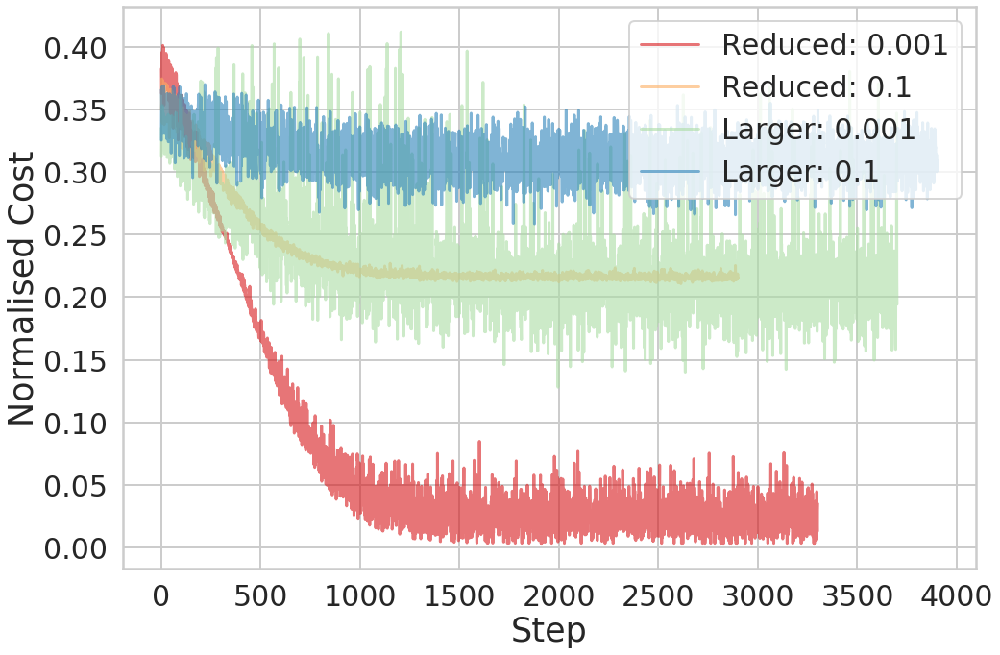

In [25]:
cmap =['#d7191c','#fdae61','#abdda4','#2b83ba']
loss_folders = [r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\tf_noise_array\2019_08_02_01_06_50', 
               r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\tf_noise_array\2019_08_02_03_25_31', 
               r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\tf_old_new_2\0-001', 
               r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\tf_old_new_2\0-1']

def plot_loss_fns(output_locs: list):
    df = pd.DataFrame()
    for folder in output_locs:
        with open(os.path.join(folder, 'saved_params.json'), 'rb') as f:
            params = json.load(f)
        if 'old' in folder:
            length = 'Larger'
        else:
            length = 'Reduced'
        loss_fn = np.load(os.path.join(folder, 'outputs', 'loss_fn.npy'))
        noise = params['noise_prob']
        df = df.append({'noise': noise, 'step': loss_fn[0], 'loss': loss_fn[1], 'lab': length}, ignore_index=True)
    df['noise'] = df['noise'].astype('category')
    for i, row in df.iterrows():
        # sns.scatterplot(x='step', y='loss', style='noise', data=df, hue='noise', palette=noise_pal)
        plt.plot(row['step'], row['loss'], label='{}: {}'.format(row['lab'], row['noise']), alpha=0.6)
    plt.xlabel('Step')
    plt.ylabel('Loss')
    plt.title('Loss functions for example runs\nof the algorithm')
    plt.legend()
    df.to_pickle(r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\loss_fn_df.pkl')
    plt.show()

# plot_loss_fns(loss_folders)
df = pd.read_pickle(r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\loss_fn_df.pkl')
fig = plt.figure(figsize=(15,10))
ax = fig.add_subplot(111)
for i, row in df.iterrows():
    ax.plot(row['step'], row['loss'], label='{}: {}'.format(row['lab'], row['noise']), alpha=0.6, color=cmap[i])
plt.xlabel('Step', fontsize=35)
plt.ylabel('Normalised Cost', fontsize=35)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
# plt.title('Loss functions for example runs\nof the algorithm')
plt.legend(fontsize=30, loc='upper right')
plt.tight_layout()
plt.savefig(os.path.join(image_direc, 'loss_fns_all.pdf'), bbox_inces='tight')

In [12]:
deep=["#4C72B0", "#55A868", "#C44E52",
      "#8172B2", "#CCB974", "#64B5CD"]
muted=["#4878CF", "#6ACC65", "#D65F5F",
       "#B47CC7", "#C4AD66", "#77BEDB"]
pastel=["#92C6FF", "#97F0AA", "#FF9F9A",
        "#D0BBFF", "#FFFEA3", "#B0E0E6"]
bright=["#003FFF", "#03ED3A", "#E8000B",
        "#8A2BE2", "#FFC400", "#00D7FF"]
dark=["#001C7F", "#017517", "#8C0900",
      "#7600A1", "#B8860B", "#006374"]
colorblind=["#0072B2", "#009E73", "#D55E00",
            "#CC79A7", "#F0E442", "#56B4E9"]
pal = deep
noise_pal = {0.0: pal[0], 0.0005: pal[1], 0.001: pal[2], 0.005: pal[3],  0.01: pal[4], 0.05: pal[5], 0.1: pal[0], 0.25:pal[1], 0.5:pal[2], 0.75:pal[3]}
filled_markers = ('o', 'v', '^', '<', '>', '8', 's', 'p', '*', 'h', 'H', 'D', 'd', 'P', 'X')

def compare_val_tr_noise_mu(directory: str, folders: list):
    df  = pd.DataFrame()
    folder_list = [os.path.join(directory, f) for f in folders]
    for run in folder_list:
        for f in [os.path.join(run, a) for a in os.listdir(run)]:
            if os.path.exists(os.path.join(f, 'saved_params.json')):
                df = df.append(create_noise_levels_df(f))
    f, ax = plt.subplots(figsize=(7,7))

    numeric = ['cost_err', 'cost_inc', 'noise_prob', 'loss', 'mu_a']
    df[numeric] = df[numeric].apply(pd.to_numeric, errors='coerce', axis=1)
    for x in [0.0005, 0.005, 0.25, 0.0001]:
        df = df[df.training_noise != x]
    df['training_noise_cat'] = df['training_noise'].astype('category')
    df['mu_a_cat'] = df['mu_a'].astype('category')
    df['training_noise_log'] = df['training_noise']*1000
            
    sns.scatterplot(x='noise_prob', y='loss', style='mu_a_cat', data=df, hue='training_noise', palette=noise_pal, s=100, alpha=0.5)

    if not os.path.exists(os.path.join(directory, 'output')):
        os.mkdir(os.path.join(directory, 'output'))
    #plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(xscale='log')
#     ax.set_title('Loss against noise level in validation circuit \nfor different levels of training noise.', fontsize=23)
    ax.set_xlabel('Validation noise level', fontsize=18)
    ax.set_ylabel('Loss', fontsize=18)
    ax.xaxis.set_tick_params(labelsize=16)
    ax.yaxis.set_tick_params(labelsize=16)
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles=handles[1:], labels=labels[1:], title="Training noise level", title_fontsize=16, fontsize=14)
    ax.set(xlim=(0.00045, 0.12))#, ylim=(0.12,0.18))


    plt.savefig(os.path.join(directory, 'output', 'noise_mu_plot.png'))
    df.to_pickle(os.path.join(directory, 'output', 'noise_mu_df.pkl'))
        

# comparisons = ['tf_noise_array_mu09', 'tf_noise_array_mu075', 'tf_noise_array_new', ]
# direc = r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs'
# compare_val_tr_noise_mu(direc, comparisons)

In [13]:
direc = r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\tf_repeats'
def return_big_df(grouped_loc: str):
    n_obs = 0
    folders = [f for f in os.listdir(grouped_loc) if os.path.isdir(os.path.join(grouped_loc, f))]
    big_df = pd.DataFrame()
    for f in folders:
        run_df = pd.DataFrame()
        fol = os.path.join(grouped_loc, f)
        for folder in [os.path.join(fol, a) for a in os.listdir(fol) if os.path.isdir(os.path.join(fol, a))]:
            if os.path.exists(os.path.join(folder, 'saved_params.json')):
                df = create_noise_levels_df(folder)
                numeric = ['cost_err', 'cost_inc', 'noise_prob', 'loss', 'mu_a', 'sigma_a', 'a_a', 'a_b', 'a_inc', 'b_a', 'b_b', 'b_inc']
                df[numeric] = df[numeric].apply(pd.to_numeric, errors='coerce', axis=1)
                df['training_noise_cat'] = df['training_noise'].astype('category')
                run_df = run_df.append(df)
                n_obs += 1
        big_df = big_df.append(run_df, ignore_index=True)
    return big_df, n_obs


uge_df = pd.DataFrame()
n = 0
direc = r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs'
top = ['many_mu', 'min_err_60_10', 'noise_array']


for c in [os.path.join(direc, t) for t in top]:
    df, n0 = return_big_df(c)
    uge_df = uge_df.append(df)
    n = n + n0
repeats = os.path.join(direc, 'tf_repeats')
for folder in [os.path.join(repeats, a) for a in os.listdir(repeats) if os.path.isdir(os.path.join(repeats, a))]:
    if os.path.exists(os.path.join(folder, 'outputs_with_noise_levels', '0_05', 'probs.npy')):
        df = create_noise_levels_df(folder)
        numeric = ['cost_err', 'cost_inc', 'noise_prob', 'loss', 'mu_a', 'sigma_a', 'a_a', 'a_b', 'a_inc', 'b_a', 'b_b', 'b_inc']
        df[numeric] = df[numeric].apply(pd.to_numeric, errors='coerce', axis=1)
        df['training_noise_cat'] = df['training_noise'].astype('category')
        uge_df = uge_df.append(df, ignore_index=True)
        n = n + 1
        
uge_df = uge_df[uge_df.angles.map(len) == 14]
col_names = ['theta_{}'.format(i) for i in range(len(uge_df.angles[0]))]
uge_df[col_names] = pd.DataFrame(uge_df.angles.values.tolist(), index=uge_df.index)
uge_df.drop('angles', axis=1, inplace=True)
uge_df

,P_err,P_inc,a_a,a_b,a_inc,b_a,b_b,b_inc,cost_err,cost_inc,...,theta_4,theta_5,theta_6,theta_7,theta_8,theta_9,theta_10,theta_11,theta_12,theta_13
0,0.042735,2.328603e-09,0.914296,0.085469,4.657206e-09,5.847479e-09,1.000000,0.000000e+00,40.0,40.0,...,10.750184,9.572158,2.978449,0.606271,6.286652,12.516823,2.980421,8.347977,9.422811,10.147713
1,0.044775,1.003951e-03,0.911570,0.086261,2.005485e-03,3.289887e-03,0.996704,2.415850e-06,40.0,40.0,...,10.750184,9.572158,2.978449,0.606271,6.286652,12.516823,2.980421,8.347977,9.422811,10.147713
2,0.045722,1.999530e-03,0.908861,0.087072,3.999060e-03,4.373065e-03,0.993418,0.000000e+00,40.0,40.0,...,10.750184,9.572158,2.978449,0.606271,6.286652,12.516823,2.980421,8.347977,9.422811,10.147713
3,0.062350,9.880880e-03,0.887778,0.092695,1.952653e-02,3.200379e-02,0.967770,2.352266e-04,40.0,40.0,...,10.750184,9.572158,2.978449,0.606271,6.286652,12.516823,2.980421,8.347977,9.422811,10.147713
4,0.080661,1.941583e-02,0.862850,0.099233,3.791719e-02,6.208817e-02,0.937008,9.144571e-04,40.0,40.0,...,10.750184,9.572158,2.978449,0.606271,6.286652,12.516823,2.980421,8.347977,9.422811,10.147713
5,0.191998,8.440920e-02,0.710908,0.138534,1.505580e-01,2.454626e-01,0.736271,1.826042e-02,40.0,40.0,...,10.750184,9.572158,2.978449,0.606271,6.286652,12.516823,2.980421,8.347977,9.422811,10.147713
6,0.270682,1.424052e-01,0.603958,0.166822,2.292199e-01,3.745406e-01,0.569880,5.559044e-02,40.0,40.0,...,10.750184,9.572158,2.978449,0.606271,6.286652,12.516823,2.980421,8.347977,9.422811,10.147713
7,0.042735,2.328603e-09,0.914296,0.085469,4.657206e-09,5.847479e-09,1.000000,0.000000e+00,40.0,40.0,...,10.750184,9.572158,2.978449,0.606271,6.286652,12.516823,2.980421,8.347977,9.422811,10.147713
8,0.042498,1.080699e-06,0.914265,0.084995,1.636578e-06,1.943833e-06,1.000000,5.248206e-07,40.0,40.0,...,3.136386,6.669009,3.429658,3.944746,7.204678,1.514845,7.260330,6.899316,11.111217,0.216994
9,0.044185,1.192907e-03,0.911722,0.085273,2.105374e-03,3.095804e-03,0.996622,2.804397e-04,40.0,40.0,...,3.136386,6.669009,3.429658,3.944746,7.204678,1.514845,7.260330,6.899316,11.111217,0.216994


In [14]:
uge_df[uge_df.noise_prob == uge_df.training_noise][uge_df.cost_err == 60][uge_df.cost_inc == 10][uge_df.mu_a == 0.5]

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,P_err,P_inc,a_a,a_b,a_inc,b_a,b_b,b_inc,cost_err,cost_inc,...,theta_4,theta_5,theta_6,theta_7,theta_8,theta_9,theta_10,theta_11,theta_12,theta_13
200,1.302827e-01,8.896827e-08,0.737267,2.605654e-01,1.779365e-07,-8.737015e-08,9.999977e-01,0.000000e+00,60.0,10.0,...,9.418062,3.137147,7.499523,3.135779,4.391280,6.872015,4.566391,6.277710,7.967616,4.218647
208,3.210875e-03,5.296736e-01,0.934095,2.534450e-03,6.336974e-02,3.887301e-03,1.344399e-04,9.959775e-01,60.0,10.0,...,0.000118,5.325632,9.871116,-0.536681,8.672231,10.606476,-0.015395,8.366504,9.842736,9.859388
216,3.814535e-03,4.936458e-02,0.836783,0.000000e+00,9.838836e-02,7.629070e-03,9.920300e-01,3.408109e-04,60.0,10.0,...,10.687035,1.868346,12.123888,9.347774,4.389885,0.364778,5.170526,4.748129,0.388138,8.541289
224,4.995754e-02,3.826924e-01,0.174713,7.271108e-02,7.525754e-01,2.720400e-02,9.599862e-01,1.280941e-02,60.0,10.0,...,1.869152,7.823187,10.365644,9.210001,2.180462,10.334586,5.696750,7.162116,8.486498,9.829782
232,6.287131e-02,6.477654e-02,0.826662,6.603896e-02,1.072988e-01,5.970366e-02,9.180415e-01,2.225430e-02,60.0,10.0,...,3.184124,13.299670,9.946721,1.180843,11.056496,4.818644,8.975452,7.754440,4.817278,1.046134
240,1.054858e-01,3.757671e-01,0.175661,0.000000e+00,6.569687e-01,2.109716e-01,6.944625e-01,9.456557e-02,60.0,10.0,...,4.461176,12.358383,0.210428,3.603924,0.002529,6.500334,9.633486,1.957680,3.143412,1.745489
248,1.691588e-01,3.185208e-01,0.254429,0.000000e+00,4.944828e-01,3.383176e-01,5.191236e-01,1.425588e-01,60.0,10.0,...,4.713296,9.450346,3.291898,6.966153,3.032992,6.861509,10.257480,12.678214,8.664422,8.959142
4455,1.274111e-01,6.289754e-07,0.739927,2.548216e-01,1.257951e-06,6.411574e-07,9.999999e-01,0.000000e+00,60.0,10.0,...,5.626909,9.137012,4.973951,12.160302,11.224480,1.350499,3.630187,11.044416,9.820825,4.150693
4460,1.274111e-01,6.289754e-07,0.739927,2.548216e-01,1.257951e-06,6.411574e-07,9.999999e-01,0.000000e+00,60.0,10.0,...,5.626909,9.137012,4.973951,12.160302,11.224480,1.350499,3.630187,11.044416,9.820825,4.150693
4461,1.272465e-01,7.432332e-04,0.740026,2.544929e-01,1.486466e-03,1.125894e-07,9.942530e-01,0.000000e+00,60.0,10.0,...,10.141851,4.768258,1.167490,11.022499,1.579022,3.494255,7.418952,10.968707,7.846758,10.641984


In [15]:
concat = uge_df.groupby(['training_noise', 'noise_prob', 'training_noise_cat'], as_index=False)
mean_df = concat.mean()
stderr = concat['loss'].std().div(np.sqrt(n)).mul(2.0)
mean_df = mean_df.join(stderr['loss'].rename('loss_err'))
n

855

<ErrorbarContainer object of 3 artists>

W1220 11:55:43.370818  1776 font_manager.py:1282] findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
W1220 11:55:43.783715  1776 font_manager.py:1282] findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.


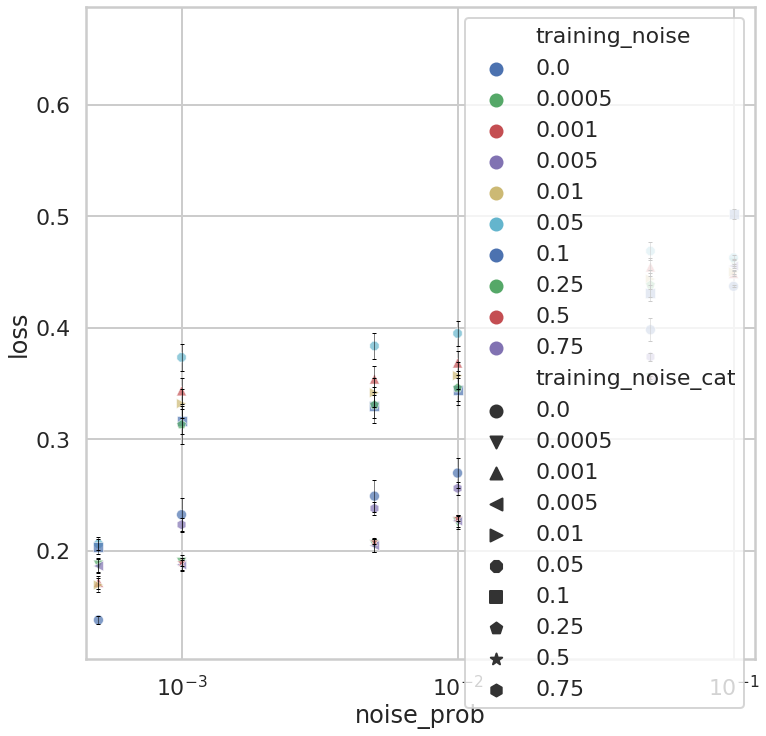

In [16]:
f, ax = plt.subplots(figsize=(12, 12))
ax.set(xscale='log', xlim=(0.00045, 0.12))
# plt.scatter(mean_df.noise_prob, mean_df.loss, c=mean_df.training_noise)
sns.scatterplot(x='noise_prob', y='loss', data=mean_df, hue='training_noise', palette=noise_pal, s=100, alpha=0.7, style='training_noise_cat', markers=filled_markers)
plt.errorbar(x=mean_df.noise_prob, y=mean_df.loss, yerr=mean_df.loss_err, fmt='none', ecolor='k', elinewidth=.5, capsize=2)

W1220 11:55:45.177199  1776 font_manager.py:1282] findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.


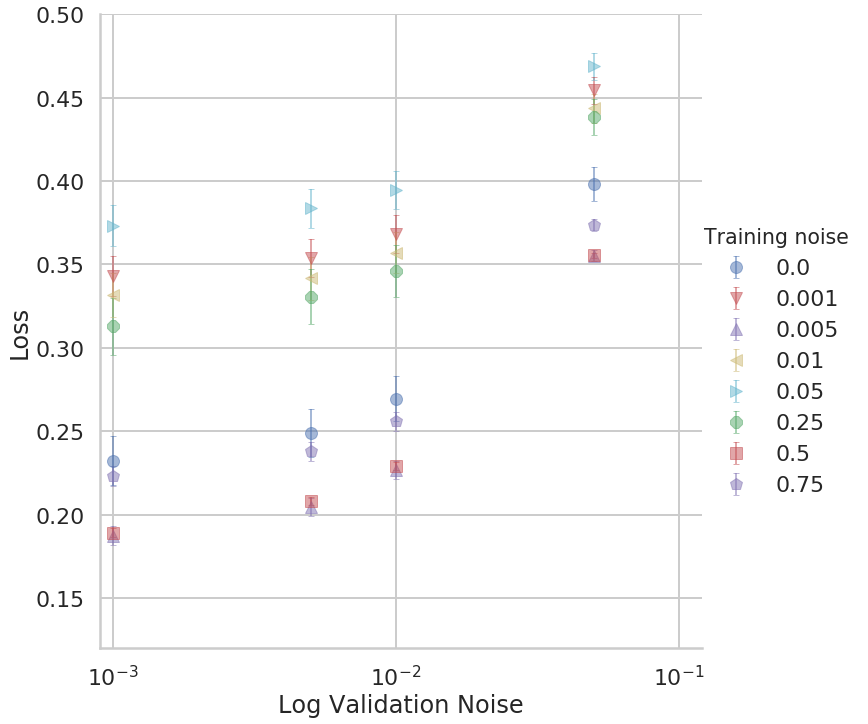

In [17]:
for x in [0.0005, 0.1]:
    mean_df = mean_df[mean_df.training_noise != x]
    mean_df = mean_df[mean_df.noise_prob != x]

g = sns.FacetGrid(mean_df, hue='training_noise',palette=noise_pal, hue_kws=dict(marker=filled_markers), height=10)
g = g.map(plt.errorbar, 'noise_prob', 'loss', 'loss_err', fmt='x', elinewidth=2, capsize=3, alpha=.5).set(xlim=(0.0009, 0.12), xscale='log', ylim=(0.12, 0.5), alpha=.5)
g.add_legend(title='Training noise')
g.set_axis_labels(x_var='Log Validation Noise', y_var='Loss')

In [18]:
# d = r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\tf_repeats'
# for folder in [os.path.join(d, f) for f in  os.listdir(d) if os.path.isdir(os.path.join(d, f))]:
#     p_loc = os.path.join(folder, 'saved_params.json')
#     if os.path.exists(p_loc):
#         with open(p_loc, 'rb') as file:
#             params = json.load(file)
#         if params['noise_prob'] == 0.5:
#             print(folder)
print(np.mean(uge_df[uge_df.training_noise == 0.5][uge_df.noise_prob == 0.0].loss))
print(np.mean(uge_df[uge_df.training_noise == 0.1][uge_df.noise_prob == 0.0].loss))
print(np.mean(uge_df[uge_df.training_noise == 0.001][uge_df.noise_prob == 0.0].loss))

0.18950488997830284
0.31687803858125857
0.3427741694962606


c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:9: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if __name__ == '__main__':
c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  # Remove the CWD from sys.path while we load stuff.
c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  # This is added back by InteractiveShellApp.init_path()


c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


<Figure size 720x720 with 0 Axes>

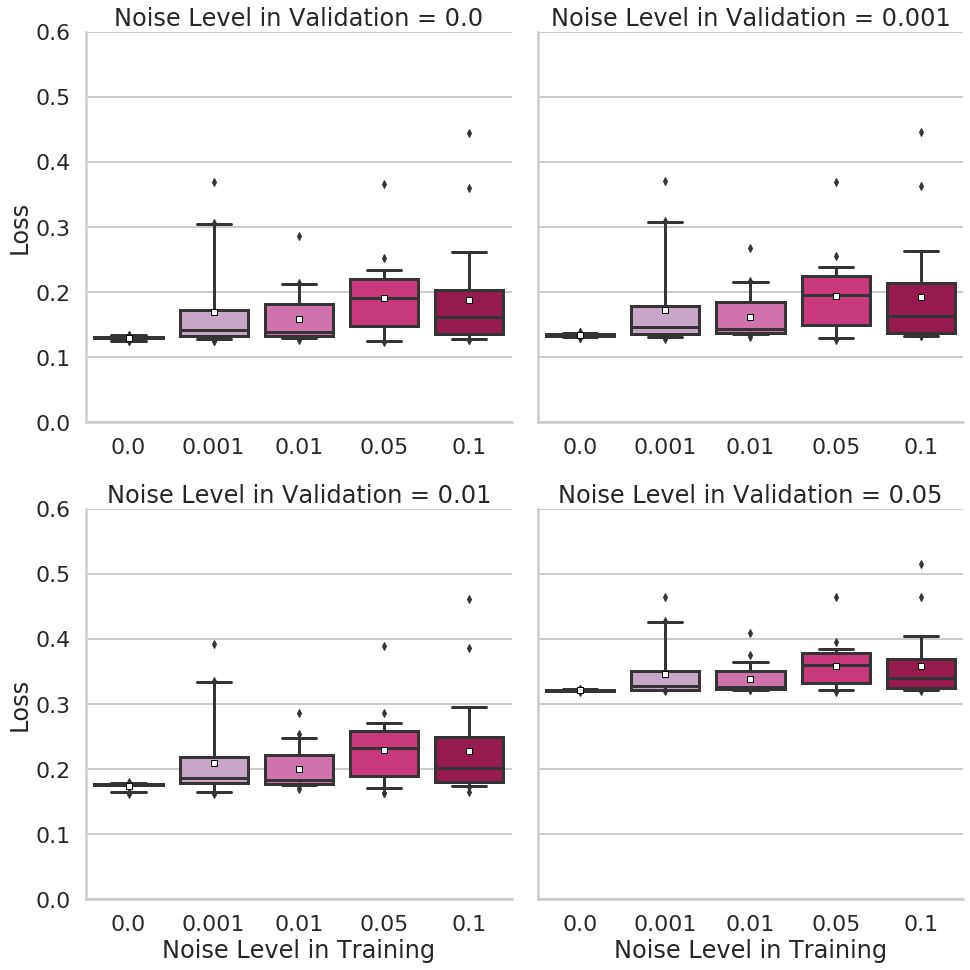

In [30]:
plot_df = copy.copy(uge_df)
for x in [0.0005, 0.005, 0.1]:
    plot_df = plot_df[plot_df.noise_prob != x]
for x in [0.0005, 0.005, 0.0001,  0.25, 0.75, 0.5]:
    plot_df = plot_df[plot_df.training_noise != x]
plot_df = plot_df[plot_df.cost_err == plot_df.cost_inc][plot_df.mu_a == 0.5]
fig  = plt.figure(figsize=(10, 10))
g = sns.catplot(x='training_noise', y='loss', data=plot_df, col='noise_prob', col_wrap=2, height=7, 
                kind='box', sharey=True, sharex=False,  whis=[5,95], showmeans=True,
                palette= 'PuRd',
                meanprops={'marker':'s', 'markerfacecolor':'white', 'markeredgecolor':'black'})
g.set_axis_labels(x_var='Noise Level in Training', y_var='Loss')
g.set_titles(col_template="Noise Level in Validation = {col_name}")
g.set(ylim=(0, 0.6))
plt.tight_layout()
plt.savefig(os.path.join(image_direc, 'noise_box_plot.png'), bbox_inces='tight')

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  after removing the cwd from sys.path.


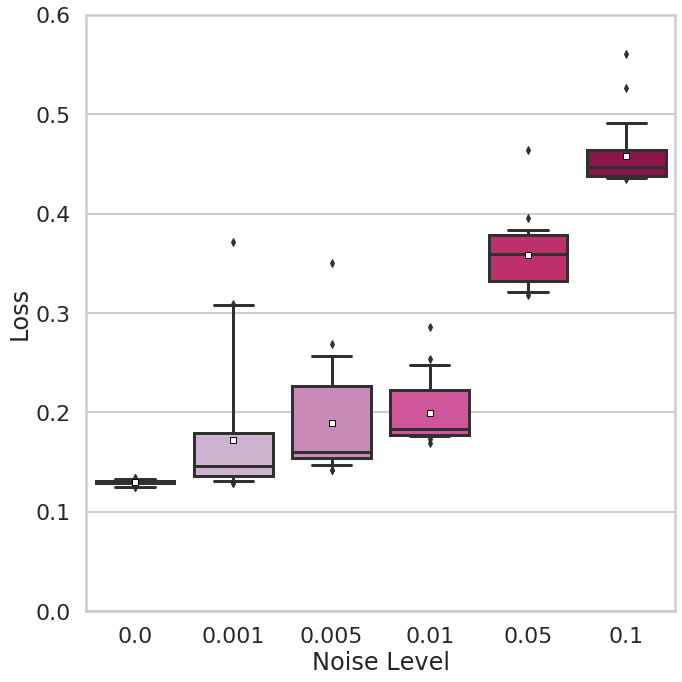

In [31]:
tr_df = copy.copy(uge_df)
for x in [0.0005, 0.25, 0.5, 0.75]:
    tr_df = tr_df[tr_df.training_noise_cat != x]
tr_df = tr_df[tr_df.noise_prob == tr_df.training_noise][tr_df.cost_err == tr_df.cost_inc][tr_df.mu_a == 0.5]
fig, ax  = plt.subplots(figsize=(10,10))
sns.boxplot(x='training_noise_cat', y='loss', data=tr_df, ax=ax,  whis=[5,95], showmeans=True,
            palette='PuRd',
                meanprops={'marker':'s', 'markerfacecolor':'white', 'markeredgecolor':'black'},)
ax.set(xlabel='Noise Level', ylabel='Loss', ylim=(0, 0.6))
plt.tight_layout()
plt.savefig(os.path.join(image_direc, 'noise_array_box.png'), bbox_inches='tight')

In [32]:
def create_angles_df(df: pd.DataFrame, mod_pi: bool = True):
    if mod_pi:
        df['mod_pi'] = np.mod(df.angles, 2 * np.pi)
        col_names = ['theta_{}'.format(i) for i in range(len(df.mod_pi[0]))]
        df[col_names] = pd.DataFrame(df.mod_pi.values.tolist(), index=df.index)
    else:
        col_names = ['theta_{}'.format(i) for i in range(len(df.angles[0]))]
        df[col_names] = pd.DataFrame(df.angles.values.tolist(), index=df.index)
    return df

In [33]:
balanced = uge_df[uge_df.cost_err == uge_df.cost_inc]
min_err = uge_df[uge_df.cost_err != uge_df.cost_inc]

balanced = balanced[balanced.noise_prob == balanced.training_noise]
min_err = min_err[min_err.noise_prob == min_err.training_noise]
balanced_05 = balanced[balanced.mu_a == 0.5]

for i in range(14):
    balanced_05['theta_{}'.format(i)] = np.mod(balanced_05['theta_{}'.format(i)], (2*np.pi))
max(balanced_05['theta_0'])

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':


6.283170700073242

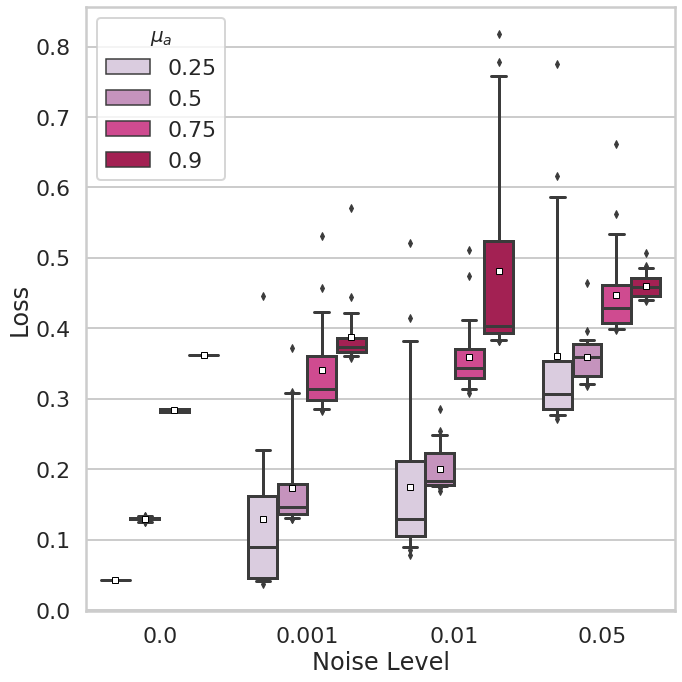

In [35]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
plot_mu = copy.copy(balanced)
for x in [0.0005, 0.005, 0.1, 0.25, 0.5, 0.75]:
    plot_mu = plot_mu[plot_mu.noise_prob != x]
plot_mu = plot_mu[plot_mu.noise_prob == plot_mu.training_noise]
sns.boxplot(x='noise_prob', y='loss', hue='mu_a', data=plot_mu, showmeans=True, whis=[5,95],
            palette='PuRd',
                meanprops={'marker':'s', 'markerfacecolor':'white', 'markeredgecolor':'black'}, ax=ax)
ax.set(xlabel='Noise Level', ylabel='Loss')
ax.legend(title='$\mu_a$', title_fontsize=20)
plt.tight_layout()
plt.savefig(os.path.join(image_direc, 'mu_increasing.png'), bbox_inces='tight')

In [36]:
uge_df[uge_df.cost_err == uge_df.cost_inc][uge_df.noise_prob == uge_df.training_noise][uge_df.mu_a == 0.25].noise_prob.unique()

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


array([0.    , 0.0005, 0.001 , 0.005 , 0.01  , 0.05  , 0.1   ])

In [37]:
def plot_angle_dist(df: pd.DataFrame, ylim: bool = True, save_theta: int = None):
    for theta in df:
        if 'theta' in theta:
            n = int(re.findall(r'\d+', theta)[0]) + 1
            fig = plt.figure(figsize=(10,10))
            n_levels = len(df.training_noise.unique())
            rows = int(n_levels / 2)
            cols = int(n_levels / 2) + (n_levels % 2 )
            gs = gridspec.GridSpec(rows, cols, figure=fig)
            for i, level in enumerate(df.training_noise.unique()):
                p = df[df.training_noise == level]
                # plot = sns.jointplot(x=p[theta], y=p.loss, kind='kde', space=0, n_levels=10, shade_lowest=False, bw=.4)
                plot = (sns.jointplot(theta, 'loss', data=p, color='black', alpha=.7, marker='o', s=10, marginal_kws={'bins':10})
                        .plot_joint(sns.kdeplot, zorder=0, alpha=1, n_levels=5, shade_lowest=False, shade=True, bw=.15, cmap='YlOrBr'))
                plot.ax_joint.set_xlabel('$\\theta_{{{}}}$ \nNoise level = {}'.format(n, level))
                plot.ax_joint.set_ylabel('Loss')
                plot.ax_joint.set_xlim((0, 2*np.pi))
                if ylim:
                    plot.ax_joint.set_ylim((0.1, 0.4))
                g = SeabornFig2Grid(plot, fig, gs[i])
            gs.tight_layout(fig)
            if save_theta == n:
                plt.savefig(os.path.join(image_direc, 'theta_{}.pdf'.format(n)), bbox_inces='tight')

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


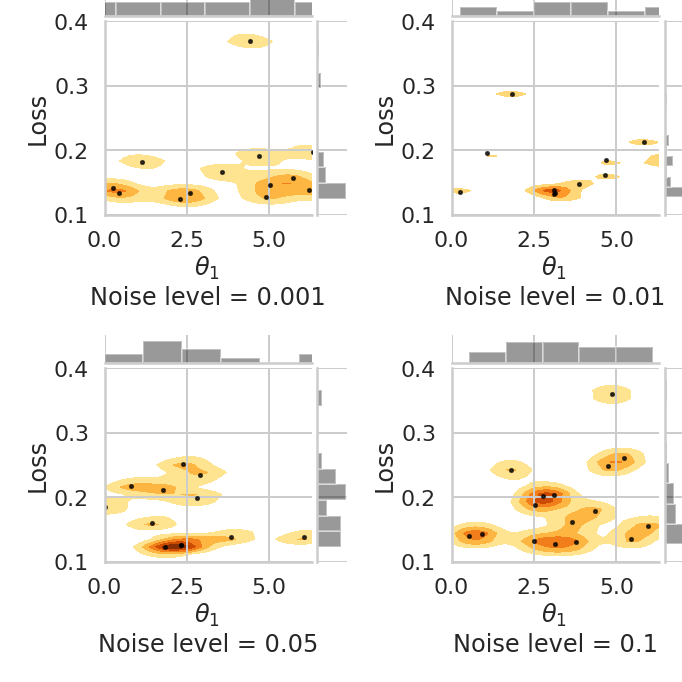

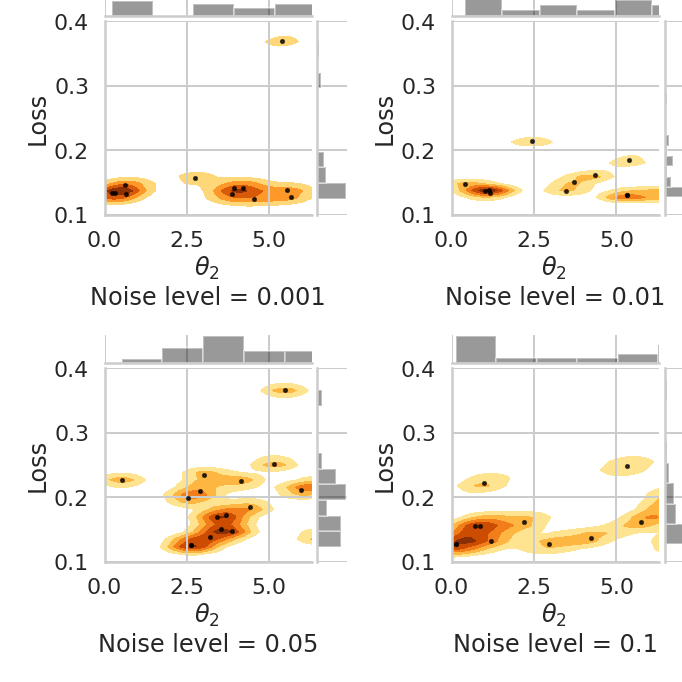

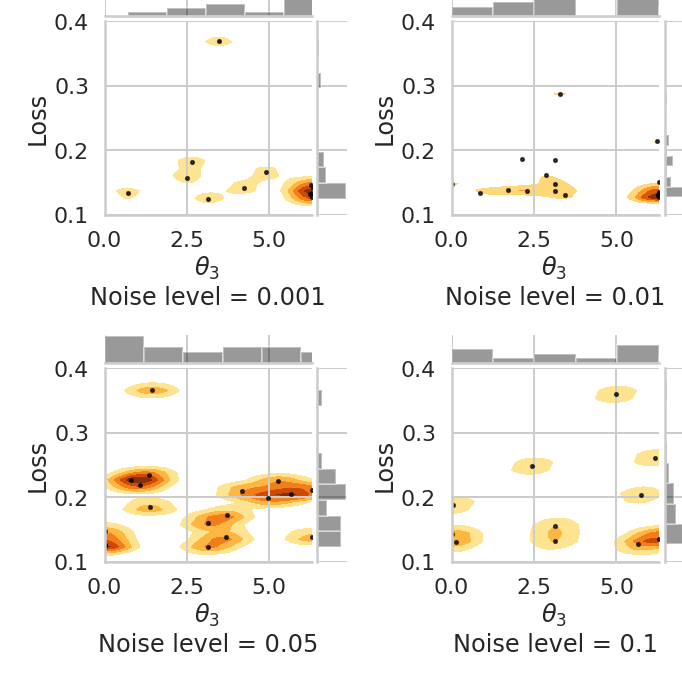

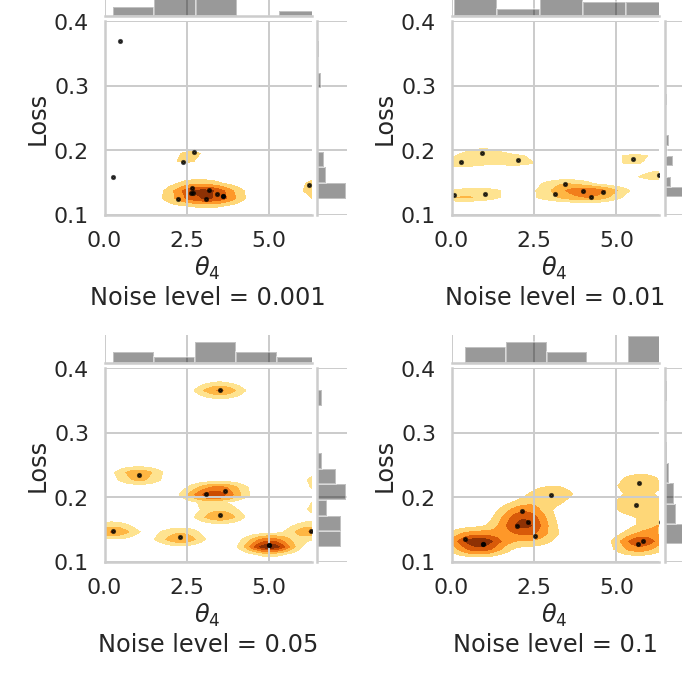

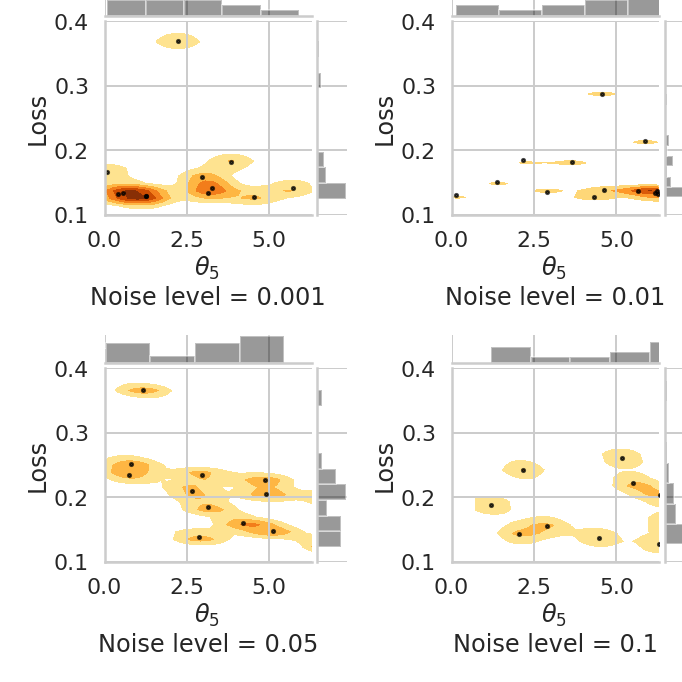

...

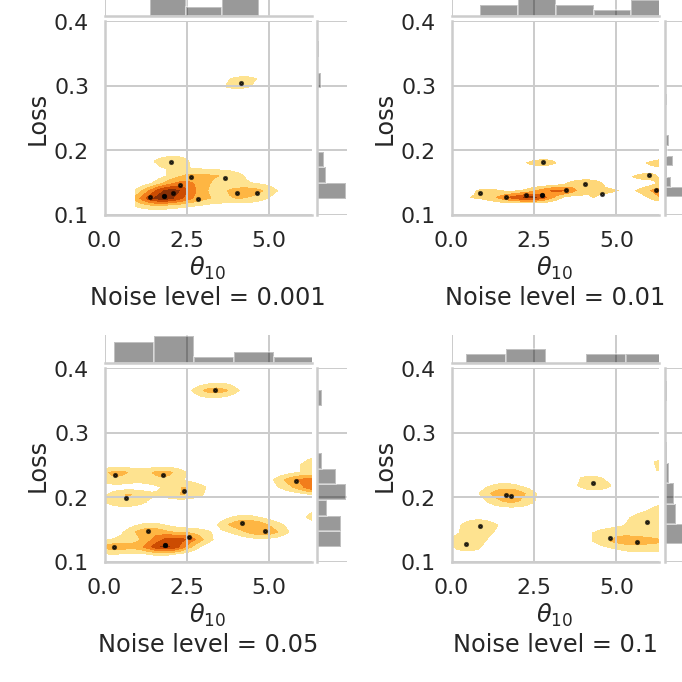

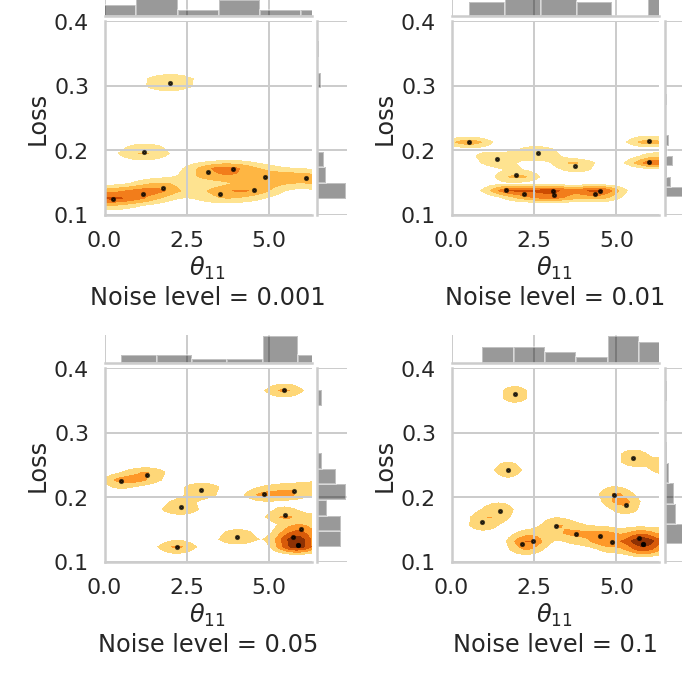

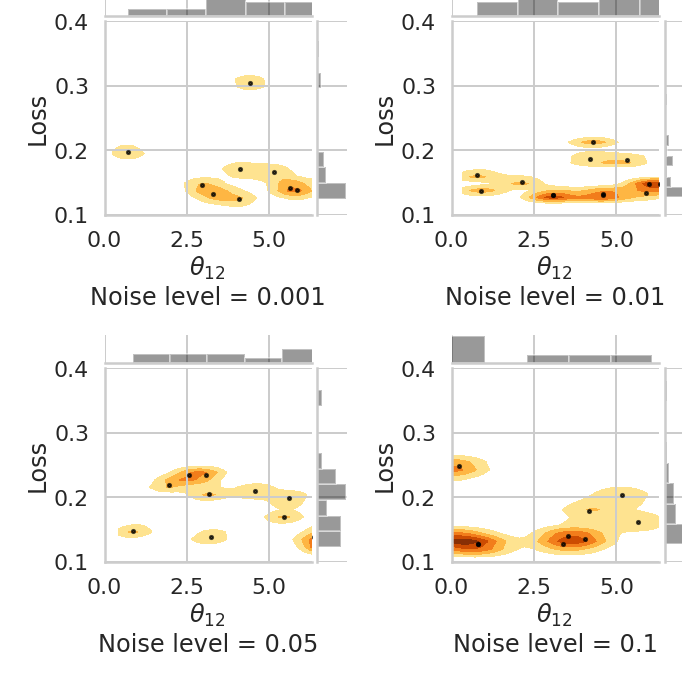

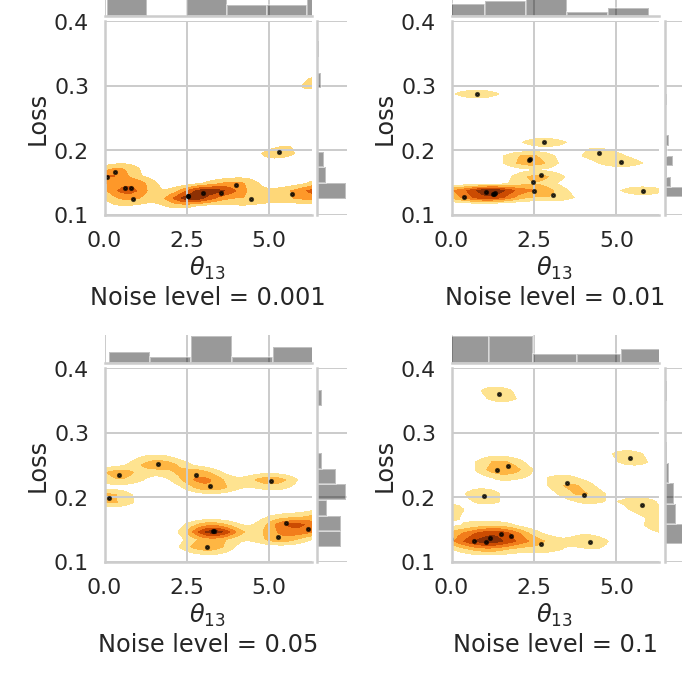

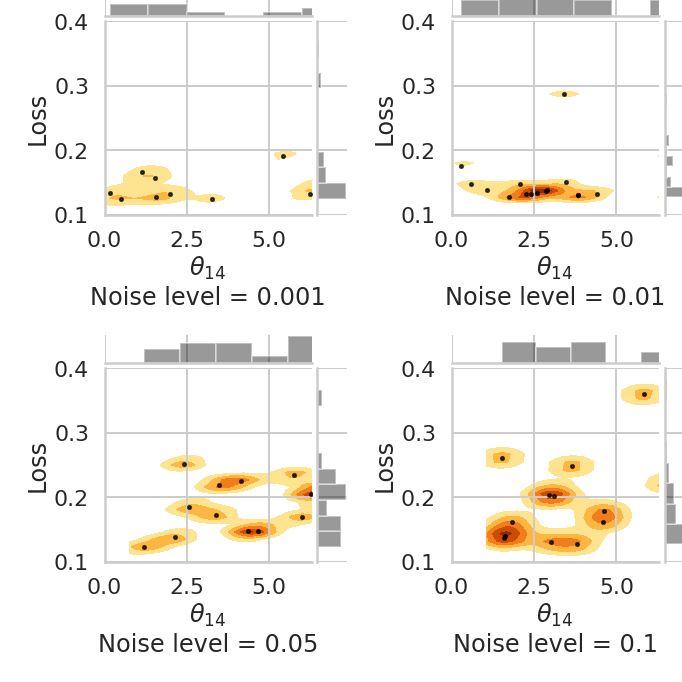

In [38]:
b_rm = uge_df[uge_df.mu_a == 0.5][uge_df.cost_err == uge_df.cost_inc][uge_df.noise_prob == 0.0]
for x in [0.0005, 0.005, 0.0, 0.25, 0.75, 0.5]:
    b_rm = b_rm[b_rm.training_noise != x]
plot_angle_dist(b_rm, True, 10)

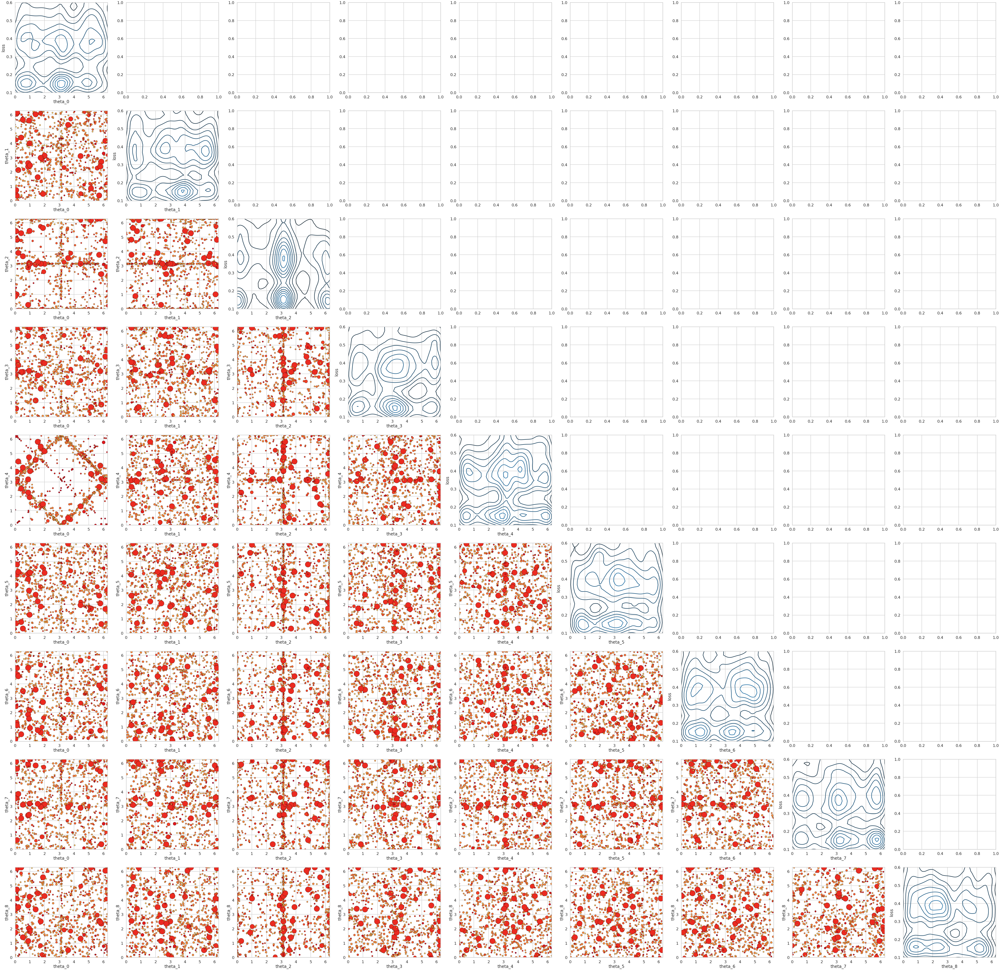

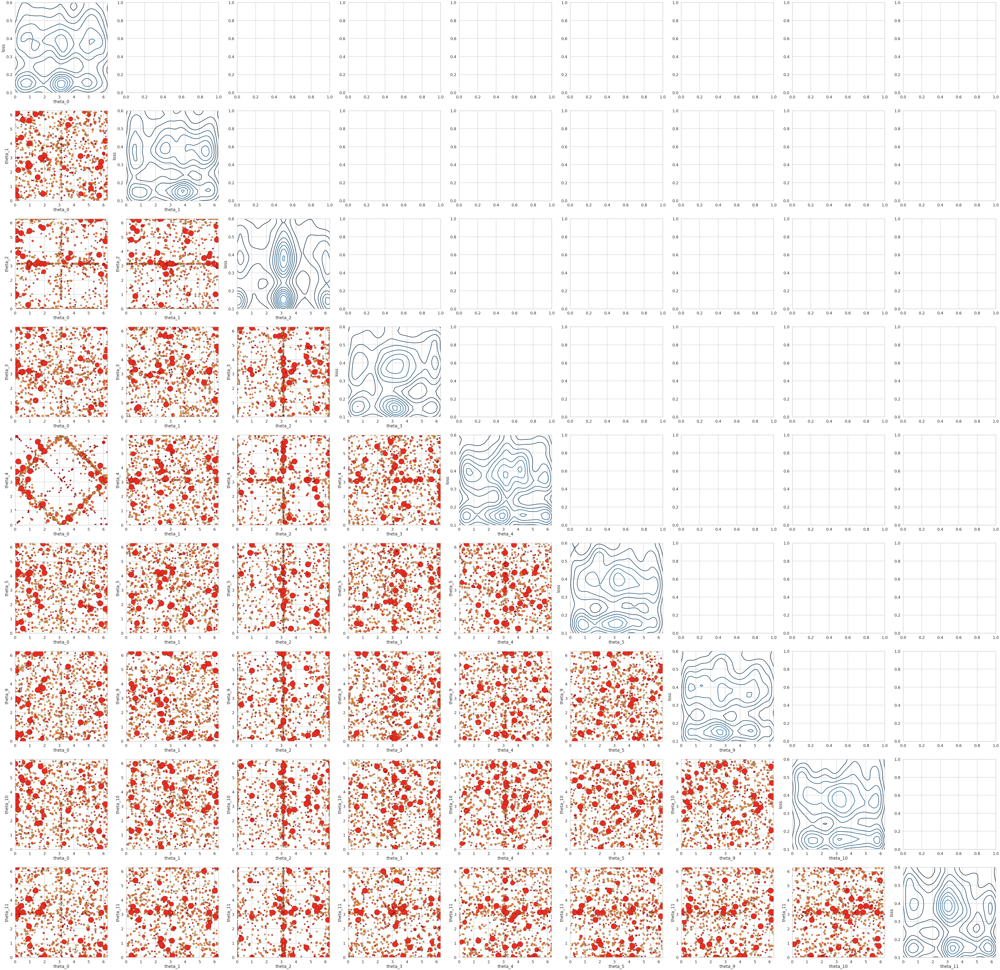

In [32]:
# p = uge_df
# for i in range(14):
#     p['theta_{}'.format(i)] = np.mod(p['theta_{}'.format(i)], (2*np.pi))
# angles = [[0,1,2,3,4,5,6,7,8],[0,1,2,3,4,5,9,10,11]]
# for a in [0,1]:
#     n_rows = 9
#     n_cols = 9
#     fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(100,100))
#     for i in range(n_rows):
#         for j in range(n_cols):
#             if i == j:            
#                 plot = sns.kdeplot(p['theta_{}'.format(angles[a][i])], p['loss'], ax=axs[i,j], bw=.2)
#     #             plot.set_xlabel('$\\theta_0$')
#     #             plot.set_ylabel('Loss')
#                 plot.set_xlim(0,2*np.pi)
#                 plot.set_ylim(0.1, 0.6)
#                 break
#             else:
#                 plot = sns.scatterplot(x='theta_{}'.format(angles[a][j]), y='theta_{}'.format(angles[a][i]), data=p, size='noise_prob', hue='loss', palette='YlOrRd', sizes=(0, 1000), legend=False, edgecolor='black', ax=axs[i,j])
#     #             plot.set_xlabel('$\\theta_0$')
#     #             plot.set_ylabel('$\\theta_{{{}}}$'.format(i))
#                 plot.set_xlim(0,2*np.pi)
#                 plot.set_ylim(0,2*np.pi)

#     plt.show()

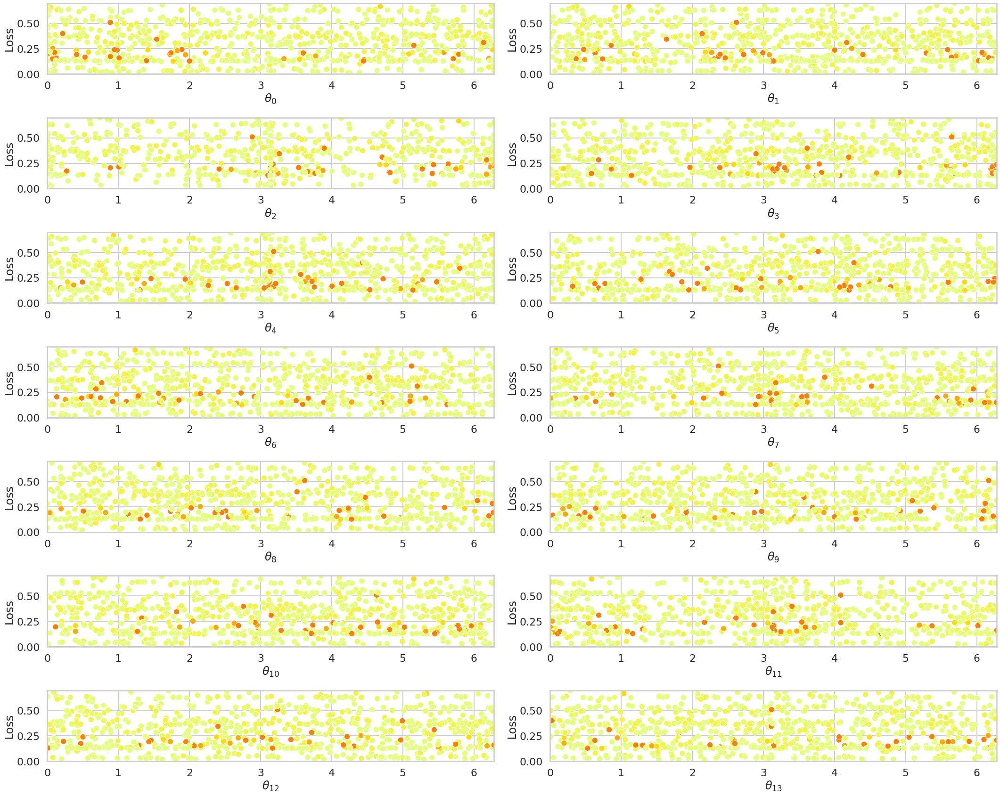

In [33]:
# pal = dark
# noise_pal = {0.0: pal[0], 0.0001: pal[1], 0.0005: pal[2], 0.001: pal[3], 0.005: pal[4],  0.01: pal[5], 0.05: pal[0], 0.1: pal[1], 0.25:pal[2]}
# p = p[p.noise_prob == 0.0]
# fig, axs = plt.subplots(7, 2, figsize=(30,24))
# # gs = gridspec.GridSpec(3,3)
# for i in range(14):
#     plot = sns.scatterplot(x=p['theta_{}'.format(i)], y=p.loss, hue=p.training_noise_cat, palette='Wistia', ax=axs.flat[i], legend=False)
#     plot.set_xlabel('$\\theta_{{{}}}$'.format(i))
#     plot.set_ylabel('Loss')
#     plot.set_xlim(0,2*np.pi)
#     plot.set_ylim(0, 0.7)
# # g = SeabornFig2Grid(plot, fig, gs[i])

# # gs.tight_layout(fig)
# plt.tight_layout()
# plt.show()

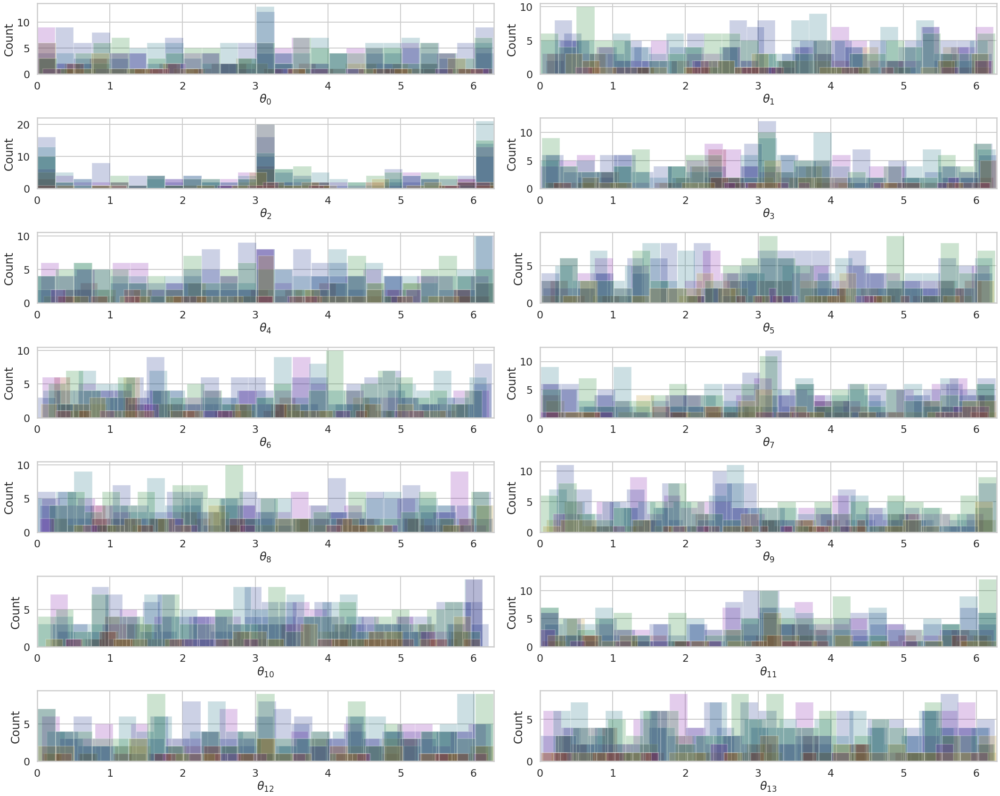

In [34]:
# pal = dark
# noise_pal = {0.: pal[0], 0.0001: pal[1], 0.0005: pal[2], 0.001: pal[3], 0.005: pal[4],  0.01: pal[5], 0.05: pal[0], 0.1: pal[1], 0.25:pal[2], 0.5:pal[3], 0.75:pal[4]}
# p = p[p.noise_prob == 0.0][p.cost_err == p.cost_inc]

# fig, axs = plt.subplots(7, 2, figsize=(30,24))

# for i in range(14):
#     for j in p.training_noise.unique():
#         plot = sns.distplot(p['theta_{}'.format(i)][p.training_noise == j], bins=25, color=noise_pal[j], kde=False, ax=axs.flat[i], hist_kws={'alpha': .2})
#     plot.set_xlabel('$\\theta_{{{}}}$'.format(i))
#     plot.set_ylabel('Count')
#     plot.set_xlim(0,2*np.pi)
# plt.tight_layout()

In [39]:
%matplotlib inline
def create_bar_plot_errors(prob_pure: np.ndarray, prob_mixed: np.ndarray, pure_err: np.ndarray, mixed_err: np.ndarray):
    x = []
    y = []
    dz = []
    err = []

    classes = np.array([0, 1, 2])
    xticks = [0, 1]
    ylabs = ['$a$ States', '$b$ States', 'Inconclusive']
    xlabs = ['$a$ States', '$b$ States']
    data = np.stack([prob_pure, prob_mixed])
    errors = np.stack([pure_err, mixed_err])

    for r, row in enumerate(data):
        for c, col in enumerate(row):
            x.append(xticks[r])
            y.append(classes[c])
            dz.append(col)
    
    for r, row in enumerate(errors):
        for c, col in enumerate(row):
            err.append(col)

    z = np.zeros(len(y))
    dx = np.ones(len(y)) * 0.5
    dy = np.ones(len(y)) * 0.5

    ax3d = plt.figure(figsize=(15,15)).gca(projection='3d')
    colours = ['#7E57C2', '#7E57C2', '#7E57C2', '#707B7C', '#707B7C', '#707B7C']
    ax3d.bar3d(x, y, z, dx, dy, dz, color=colours, edgecolor='black', alpha=.5)
    
#     pdb.set_trace()
    for i, j in enumerate(dz):
        ax3d.plot([x[i] + 0.25, x[i] + 0.25], [y[i] + 0.25, y[i] + 0.25], [j + err[i], j - err[i]], 
                  color='black', marker='_', linewidth=4, markeredgewidth=4, markersize=10)

    ax3d.axes.set_yticklabels(ylabs)
    ax3d.axes.set_yticks(classes)
    ax3d.yaxis.set_rotate_label(False)
    ax3d.yaxis.labelpad = 33
    ax3d.axes.set_ylabel(r'Output', fontsize=23, linespacing=3.5)
    ax3d.yaxis._axinfo['label']['space_factor'] = 5.0
    ax3d.set_ylim(0, 2.5)

    ax3d.axes.set_xticklabels(xlabs)
    ax3d.axes.set_xticks(xticks)
    ax3d.xaxis.set_rotate_label(False)
    ax3d.xaxis.labelpad = 17
    ax3d.axes.set_xlabel('Input states', fontsize=23, linespacing=3.5)
    ax3d.xaxis._axinfo['label']['space_factor'] = 3.0

    ax3d.set_xlim(0, 1.5)

    ax3d.axes.set_zlabel('Probability', fontsize=23)
    ax3d.zaxis.labelpad = 10

    ax3d.yaxis.set_tick_params(labelsize=19, pad=12)
    ax3d.xaxis.set_tick_params(labelsize=19)
    ax3d.zaxis.set_tick_params(labelsize=19)
    plt.show()
    
pure = [0.3, 0.4, 0.3]
mixed = [0.5, 0.2, 0.3]
perr = [0.02, 0.05, 0.1]
merr = [0.1, 0.05, 0.02]
#  create_bar_plot_errors(pure, mixed, perr, merr)


In [40]:
inc = uge_df[uge_df.sigma_a == 0.01][uge_df.cost_err == 25][uge_df.training_noise == uge_df.noise_prob]
# create_bar_plot_errors(pure, mixed, p_err, m_err)

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


W1220 13:21:01.387360  1776 font_manager.py:1282] findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
W1220 13:21:01.409301  1776 font_manager.py:1282] findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
W1220 13:21:01.462160  1776 font_manager.py:1282] findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.
W1220 13:21:01.488090  1776 font_manager.py:1282] findfont: Font family ['serif'] not found. Falling back to DejaVu Sans.


Success: 0.7863655352694605 \pm 0.017141460178947895


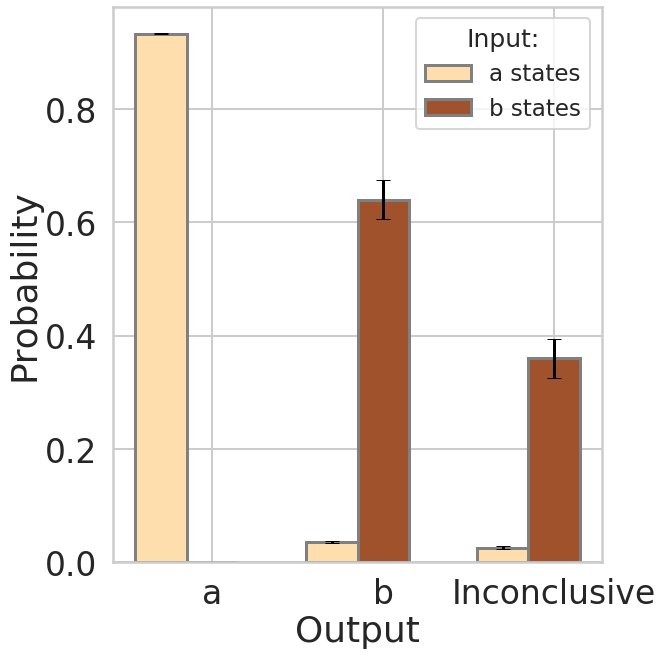

In [41]:
def output_bar_plot(df: pd.DataFrame, fname: str = None):
    sns.set_context('poster', font_scale=1.5)
    n = len(df.index)
    df = df.groupby('noise_prob')
    mean_i = df.mean()
    stderr_i = pd.DataFrame()
    for v in ['a_a', 'a_b', 'a_inc', 'b_a', 'b_b', 'b_inc']:
        stderr_i[v] = df[v].std()/(2 * np.sqrt(n))
        mean_i = mean_i.join(stderr_i[v].rename('{}_err'.format(v)))
    fig, ax = plt.subplots(figsize=(10,10))
    a_st = [mean_i['a_a'][0], mean_i['a_b'][0], mean_i['a_inc'][0]]
    b_st = [mean_i['b_a'][0], mean_i['b_b'][0], mean_i['b_inc'][0]]
    a_err = [mean_i['a_a_err'][0], mean_i['a_b_err'][0], mean_i['a_inc_err'][0]]
    b_err = [mean_i['b_a_err'][0], mean_i['b_b_err'][0], mean_i['b_inc_err'][0]]
    success = (mean_i['a_a'][0] + mean_i['b_b'][0]) /2
    suc_err = np.sqrt((mean_i['a_a_err'][0]/2)**2 + (mean_i['b_b_err'][0]/2)**2)
    bar_width = 0.3
    t1 = np.arange(len(a_st))
    t2 = [x + bar_width for x in t1]
    plt.bar(t1, a_st, width=bar_width, color='navajowhite',  yerr = a_err, capsize=7, label='a states', edgecolor='gray',linewidth=3)
    plt.bar(t2, b_st, width=bar_width, color='sienna' , yerr = b_err, capsize=7, label='b states', edgecolor='gray',linewidth=3)

    plt.xticks([r + bar_width for r in range(len(a_st))], ['a', 'b', 'Inconclusive'])
    plt.ylabel('Probability')
    plt.xlabel('Output')
    plt.legend(title='Input:', title_fontsize=25, fontsize=23)
    plt.tight_layout()
    print('Success: {} \pm {}'.format(success, suc_err))
    if fname is not None:
        plt.savefig(os.path.join(image_direc, fname), bbox_inces='tight')
    sns.set_context('poster', font_scale=1)
    
output_bar_plot(inc, 'unambiguous.pdf')

In [42]:
direc = r'C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs'
uge_df_old = pd.DataFrame()
repeats = os.path.join(direc, 'tf_old_repeats')
for folder in [os.path.join(repeats, a) for a in os.listdir(repeats) if os.path.isdir(os.path.join(repeats, a))]:
    if os.path.exists(os.path.join(folder, 'outputs_with_noise_levels', '0_05', 'probs.npy')):
        df = create_noise_levels_df(folder)
        numeric = ['cost_err', 'cost_inc', 'noise_prob', 'loss', 'mu_a', 'sigma_a', 'a_a', 'a_b', 'a_inc', 'b_a', 'b_b', 'b_inc']
        df[numeric] = df[numeric].apply(pd.to_numeric, errors='coerce', axis=1)
        df['training_noise_cat'] = df['training_noise'].astype('category')
        uge_df_old = uge_df_old.append(df, ignore_index=True)
        n = n + 1
        
#uge_df_old = uge_df_old[uge_df_old.angles.map(len) == 14]
col_names = ['theta_{}'.format(i) for i in range(len(uge_df_old.angles[0]))]
uge_df_old[col_names] = pd.DataFrame(uge_df_old.angles.values.tolist(), index=uge_df_old.index)
uge_df_old.drop('angles', axis=1, inplace=True)
uge_df_old

,P_err,P_inc,a_a,a_b,a_inc,b_a,b_b,b_inc,cost_err,cost_inc,...,theta_22,theta_23,theta_24,theta_25,theta_26,theta_27,theta_28,theta_29,theta_30,theta_31
0,0.007166,0.259793,0.962015,0.010271,0.020443,0.004061,0.496804,0.499143,25.0,2.0,...,2.390386,6.267045,10.995659,7.876497,3.141593,7.072909,8.897159,3.338147,10.740294,2.631820
1,0.014911,0.259562,0.951356,0.015257,0.025260,0.014565,0.491573,0.493863,25.0,2.0,...,2.390386,6.267045,10.995659,7.876497,3.141593,7.072909,8.897159,3.338147,10.740294,2.631820
2,0.044421,0.258766,0.916797,0.034352,0.043719,0.054489,0.471707,0.473812,25.0,2.0,...,2.390386,6.267045,10.995659,7.876497,3.141593,7.072909,8.897159,3.338147,10.740294,2.631820
3,0.078001,0.257835,0.874125,0.056028,0.064714,0.099975,0.449072,0.450955,25.0,2.0,...,2.390386,6.267045,10.995659,7.876497,3.141593,7.072909,8.897159,3.338147,10.740294,2.631820
4,0.251437,0.253120,0.656941,0.168976,0.172800,0.333897,0.332657,0.333439,25.0,2.0,...,2.390386,6.267045,10.995659,7.876497,3.141593,7.072909,8.897159,3.338147,10.740294,2.631820
5,0.007166,0.259793,0.962015,0.010271,0.020443,0.004061,0.496804,0.499143,25.0,2.0,...,2.390386,6.267045,10.995659,7.876497,3.141593,7.072909,8.897159,3.338147,10.740294,2.631820
6,0.008891,0.262805,0.952927,0.013979,0.027367,0.003804,0.497954,0.498242,25.0,2.0,...,0.736743,1.569499,3.240736,9.363665,3.141580,8.646659,6.523843,7.458371,5.109092,11.912659
7,0.015581,0.262627,0.945687,0.018255,0.031562,0.012907,0.493399,0.493693,25.0,2.0,...,0.736743,1.569499,3.240736,9.363665,3.141580,8.646659,6.523843,7.458371,5.109092,11.912659
8,0.041201,0.261581,0.910679,0.034687,0.046866,0.047716,0.475984,0.476296,25.0,2.0,...,0.736743,1.569499,3.240736,9.363665,3.141580,8.646659,6.523843,7.458371,5.109092,11.912659
9,0.070844,0.260670,0.878595,0.053864,0.065089,0.087823,0.455923,0.456251,25.0,2.0,...,0.736743,1.569499,3.240736,9.363665,3.141580,8.646659,6.523843,7.458371,5.109092,11.912659


c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


Success: 0.7234215810894966 \pm 0.0007768950399322217


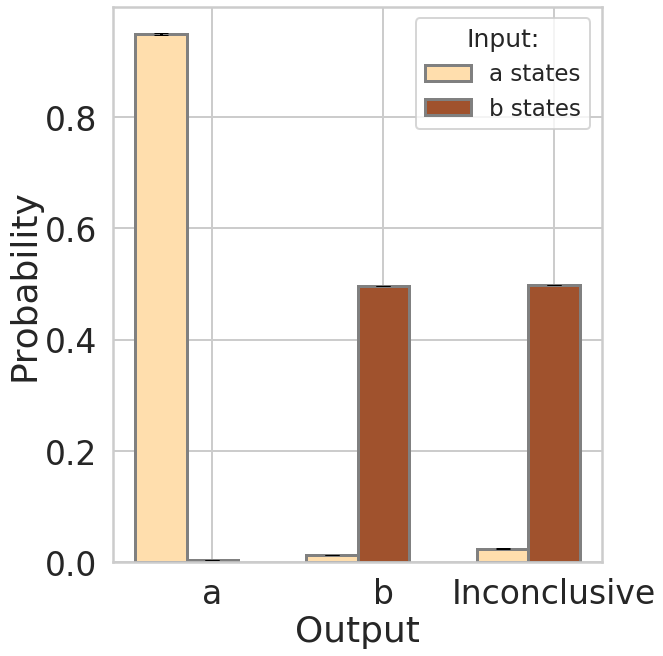

In [43]:
inc_old = uge_df_old[uge_df_old.sigma_a == 0.01][uge_df_old.cost_err == 25][uge_df_old.training_noise == uge_df_old.noise_prob]
output_bar_plot(inc_old, 'unambiguous_long.pdf')

In [44]:
uge_df_old.describe()

,P_err,P_inc,a_a,a_b,a_inc,b_a,b_b,b_inc,cost_err,cost_inc,...,theta_22,theta_23,theta_24,theta_25,theta_26,theta_27,theta_28,theta_29,theta_30,theta_31
count,394.000000,394.000000,394.000000,394.000000,3.940000e+02,394.000000,394.000000,394.000000,394.000000,394.000000,...,394.000000,394.000000,394.000000,394.000000,394.000000,394.000000,394.000000,394.000000,394.000000,394.000000
mean,0.162809,0.190525,0.834891,0.078242,7.165251e-02,0.247376,0.437048,0.309398,43.807107,26.598985,...,5.961487,6.172984,6.477621,6.002901,6.661358,6.730168,6.257676,6.128526,5.740739,6.244845
std,0.110668,0.076992,0.124643,0.064202,7.097007e-02,0.176824,0.074374,0.151697,11.914596,15.455974,...,3.769913,3.507246,3.677976,3.706344,3.958968,3.648003,3.551922,3.218914,4.117869,3.684324
min,0.005858,0.000109,0.490326,0.000530,1.209063e-08,0.002501,0.008228,0.000025,25.000000,2.000000,...,0.015984,0.002329,-0.000002,-0.006991,-1.570773,-0.081632,0.043807,0.268636,0.186895,0.301047
25%,0.045532,0.139616,0.719010,0.023965,1.963451e-02,0.054595,0.395755,0.243067,40.000000,10.000000,...,2.597331,3.165062,3.144684,2.463479,3.141558,3.149496,3.133814,3.301168,1.799922,2.849190
50%,0.174349,0.210545,0.878465,0.061019,4.016584e-02,0.271101,0.469915,0.290788,40.000000,40.000000,...,5.038335,5.921861,6.283211,5.747509,6.283672,6.291173,6.523843,6.123408,5.109092,6.144575
75%,0.255585,0.257691,0.928999,0.099759,1.339925e-01,0.395075,0.488188,0.466645,60.000000,40.000000,...,9.310224,9.423374,9.424785,9.195691,9.424446,9.425577,9.030972,8.501407,9.843990,9.743756
max,0.415314,0.271512,0.999189,0.312435,2.551151e-01,0.518544,0.501299,0.510331,60.000000,40.000000,...,12.519132,12.579916,12.565540,12.605819,12.694196,12.573948,12.523320,12.321757,12.212453,12.184114


c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\pandas\core\frame.py:7116: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,
c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if sys.path[0] == '':


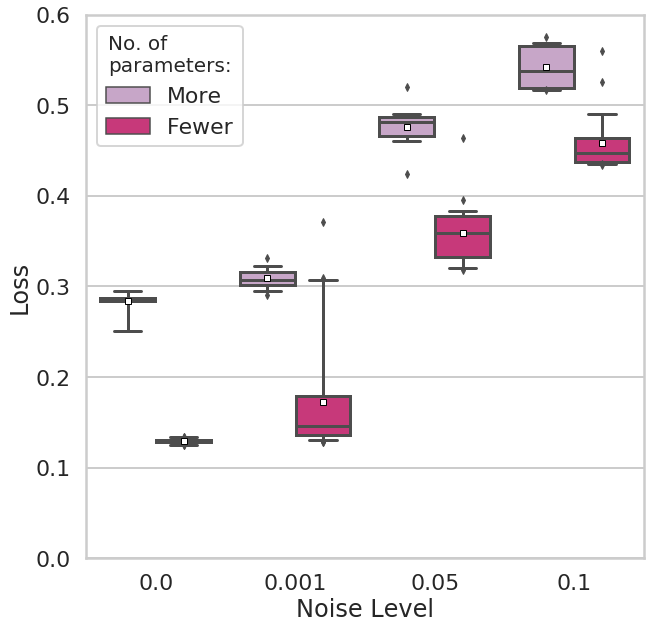

In [56]:
new = copy.copy(uge_df)
old = copy.copy(uge_df_old)
for i in range(31):
    if i < 14:
        new = new.drop('theta_{}'.format(i), axis=1)
    old = old.drop('theta_{}'.format(i), axis=1)

new['circuit'] = 'Fewer'
old['circuit'] = 'More'

plot = old.append(new, ignore_index=True)
plot = plot[plot.noise_prob == plot.training_noise][plot.cost_err == plot.cost_inc][plot.mu_a == 0.5]
for x in [0.0005, 0.005, 0.01, 0.25, 0.5, 0.75]:
    plot = plot[plot.noise_prob != x]
fig, ax  = plt.subplots(figsize=(10,10))
sns.boxplot(x='training_noise_cat', y='loss', hue='circuit', data=plot, ax=ax,  whis=[5,95], showmeans=True,  
                meanprops={'marker':'s', 'markerfacecolor':'white', 'markeredgecolor':'black'},
           palette='PuRd')
ax.set(xlabel='Noise Level', ylabel='Loss', ylim=(0,0.6))
ax.legend(title='No. of \nparameters:', title_fontsize=20)
plt.savefig(os.path.join(image_direc, 'circuit_comparison.png'), bbox_inches='tight')

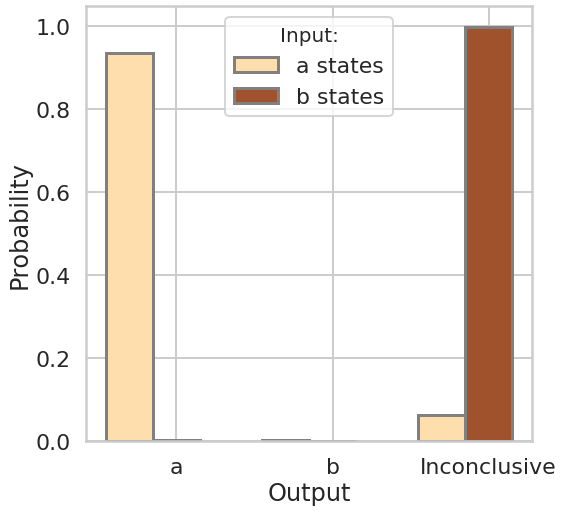

In [46]:
bad_dir = r"C:\Users\Andrew Patterson\Documents\PhD\cirq_state_discrimination\checkpoints\myriad_data\august_runs\min_err_60_10\tf_min_error\2019_08_07_14_54_34\outputs"
probs = np.load(os.path.join(bad_dir, 'probs.npy'))

fig, ax = plt.subplots(figsize=(8,8))
bar_width = 0.3
t1 = np.arange(len(probs[0]))
t2 = [x + bar_width for x in t1]
plt.bar(t1, probs[0], width=bar_width, color='navajowhite', capsize=7, label='a states', edgecolor='gray',linewidth=3)
plt.bar(t2, probs[1], width=bar_width, color='sienna', capsize=7, label='b states', edgecolor='gray', linewidth=3)

plt.xticks([r + bar_width for r in range(len(t1))], ['a', 'b', 'Inconclusive'])
plt.ylabel('Probability')
plt.xlabel('Output')
plt.legend(title='Input:', title_fontsize=20, loc='upper center')
plt.savefig(os.path.join(image_direc, 'bad_min_err.pdf'), bbox_inches='tight')
plt.show()

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until
c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\pandas\core\frame.py:7116: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,
c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\pandas\core\frame.py:7116: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=T

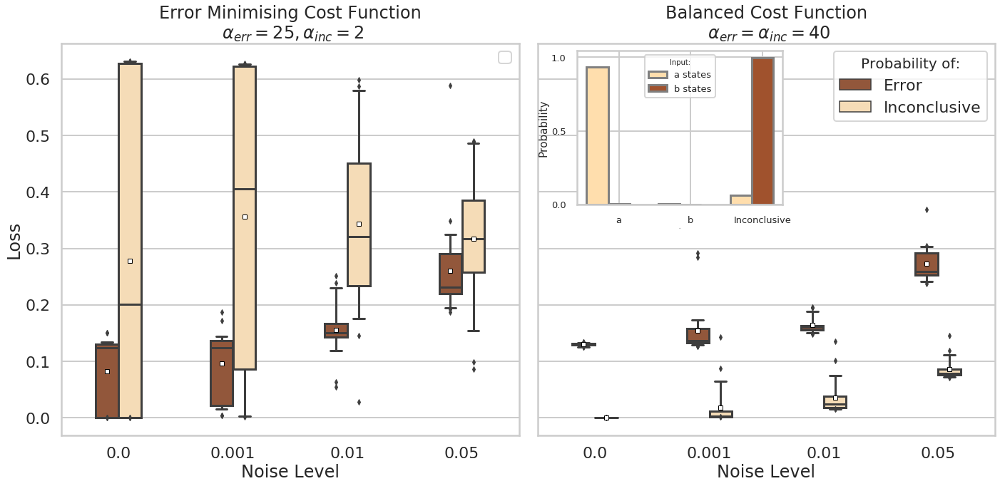

In [47]:
import matplotlib.image as mpimg
f, axs = plt.subplots(ncols=2, figsize=(20,10), sharey=True)
min_err = uge_df[uge_df.cost_err == 25][uge_df.cost_inc == 2][uge_df.mu_a == 0.5][uge_df.training_noise == uge_df.noise_prob]
c = copy.copy(min_err)
c = c.drop('P_err', axis=1)
c['P_err'] = c['P_inc']
c['spread'] = 'P_inc'
c = c[c.mu_a == 0.5]
for x in [0.0005, 0.005, 0.1]:
    c = c[c.noise_prob != x]
min_err['spread'] = 'P_err'
min_err_p  = min_err[min_err.mu_a == 0.5]
for x in [0.0005, 0.005, 0.1]:
    min_err_p = min_err_p[min_err_p.noise_prob != x]
pal = {'P_inc': 'navajowhite', 'P_err': 'sienna'}
concat= min_err_p.append(c, ignore_index=True)
min_e = sns.boxplot(x='training_noise_cat', y='P_err', hue='spread', palette=pal, data=concat, width=.4, ax=axs[0],  whis=[5,95], showmeans=True,  
                meanprops={'marker':'s', 'markerfacecolor':'white', 'markeredgecolor':'black'})


bal = copy.copy(balanced)
bal = bal[bal.mu_a == 0.5]
for x in [0.0005, 0.005, 0.1, 0.25, 0.5, 0.75]:
    bal = bal[bal.noise_prob != x]
b2 = copy.copy(bal)
b2 = b2[b2.mu_a == 0.5]
for x in [0.0005, 0.005, 0.1, 0.25, 0.5, 0.75]:
    b2 = b2[b2.noise_prob != x]
b2 = b2.drop('P_err', axis=1)
b2['P_err'] = b2['P_inc']
b2['spread'] = 'P_inc'
bal['spread'] = 'P_err'
c2 = bal.append(b2, ignore_index=True)
b = sns.boxplot(x='training_noise_cat', y='P_err', hue='spread', palette=pal, data=c2, width=.4, ax=axs[1],  whis=[5,95], showmeans=True,  
                meanprops={'marker':'s', 'markerfacecolor':'white', 'markeredgecolor':'black'})

text = ('Error', 'Inconclusive')

axs[0].set(xlabel='Noise Level', ylabel='Loss', title='Error Minimising Cost Function\n $\\alpha_{err} = 25, \\alpha_{inc} = 2$')
axs[0].legend((),())
# for t, l in zip(min_e.legend_.texts, text):
#     t.set_text(l)

axs[1].set(xlabel='Noise Level', ylabel='', title='Balanced Cost Function\n $\\alpha_{err} = \\alpha_{inc} = 40$')
# axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Probability of:')
axs[1].legend(title='Probability of:', title_fontsize=20, loc=0)
for t, l in zip(b.legend_.texts, text):
    t.set_text(l)
plt.tight_layout()

ax2 = f.add_axes([0.575, 0.575, 0.2, 0.3])
bar_width = 0.3
t1 = np.arange(len(probs[0]))
t2 = [x + bar_width for x in t1]
ax2.bar(t1, probs[0], width=bar_width, color='navajowhite', capsize=7, label='a states', edgecolor='gray',linewidth=3)
ax2.bar(t2, probs[1], width=bar_width, color='sienna', capsize=7, label='b states', edgecolor='gray',linewidth=3)

plt.xticks([r + bar_width for r in range(len(t1))], ['a', 'b', 'Inconclusive'], size=13)
plt.yticks(size=13)
plt.ylabel('Probability', size=15)
plt.xlabel('Output', size=0)
plt.legend(title='Input:', title_fontsize=10, loc='upper center', fontsize=13)

plt.savefig(os.path.join(image_direc, 'min_err_dist.pdf'), bbox_inches='tight')

In [48]:
rerun = pd.DataFrame()
repeats = os.path.join(direc, 'tf_repeats_more')
for folder in [os.path.join(repeats, a) for a in os.listdir(repeats) if os.path.isdir(os.path.join(repeats, a))]:
    if os.path.exists(os.path.join(folder, 'outputs_with_noise_levels', '0_05', 'probs.npy')):
        df = create_noise_levels_df(folder)
        numeric = ['cost_err', 'cost_inc', 'noise_prob', 'loss', 'mu_a', 'sigma_a', 'a_a', 'a_b', 'a_inc', 'b_a', 'b_b', 'b_inc']
        df[numeric] = df[numeric].apply(pd.to_numeric, errors='coerce', axis=1)
        df['training_noise_cat'] = df['training_noise'].astype('category')
        rerun = rerun.append(df, ignore_index=True)
        n = n + 1
        
rerun = rerun[rerun.angles.map(len) == len(rerun.angles[0])]
col_names = ['theta_{}'.format(i) for i in range(len(rerun.angles[0]))]
rerun[col_names] = pd.DataFrame(rerun.angles.values.tolist(), index=rerun.index)
rerun.drop('angles', axis=1, inplace=True)
rerun
noise_0001 = rerun[rerun.sigma_a == 0.15][rerun.cost_err == rerun.cost_inc][rerun.training_noise == rerun.noise_prob][rerun.training_noise == 0.001]
pd.set_option('display.max_columns', 500)
noise_0001.describe()

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:17: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


,P_err,P_inc,a_a,a_b,a_inc,b_a,b_b,b_inc,cost_err,cost_inc,loss,mu_a,noise_prob,sigma_a,training_noise,training_noise_cat,theta_0,theta_1,theta_2,theta_3,theta_4,theta_5,theta_6,theta_7,theta_8,theta_9,theta_10,theta_11,theta_12,theta_13
count,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.0,25.0,25.000000,25.0,25.000,25.00,25.000,25.000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
mean,0.162846,0.017448,0.712525,0.254055,0.028090,0.071637,0.919009,0.006806,40.0,40.0,0.180294,0.5,0.001,0.15,0.001,0.001,6.580160,7.604021,7.030161,6.049756,6.444188,6.887233,6.861095,6.260340,5.975724,6.940907,5.683528,5.718349,6.184408,7.654785
std,0.078043,0.018069,0.068816,0.057117,0.031558,0.197248,0.198612,0.013931,0.0,0.0,0.079023,0.0,0.000,0.00,0.000,0.000,3.870834,3.378277,3.247671,3.443742,4.103725,3.702549,4.263148,4.010393,3.902870,4.008137,3.847850,3.945307,3.437078,3.540952
min,0.123521,0.001734,0.613234,0.005820,0.002850,0.004431,0.000406,0.000000,40.0,40.0,0.125255,0.5,0.001,0.15,0.001,0.001,0.263459,1.015088,-0.002012,0.567897,0.089604,0.822638,-0.761032,-0.258107,0.348420,0.169568,-0.006171,-0.761089,-0.232083,0.317223
25%,0.133001,0.002260,0.675397,0.250841,0.003904,0.006436,0.947866,0.000000,40.0,40.0,0.139068,0.5,0.001,0.15,0.001,0.001,3.180521,4.641294,4.581361,3.333423,4.225336,3.967391,3.013226,2.865611,2.959395,3.908427,1.580462,2.043163,3.925078,5.570167
50%,0.136244,0.005800,0.724010,0.259160,0.011600,0.012727,0.984131,0.000302,40.0,40.0,0.157963,0.5,0.001,0.15,0.001,0.001,6.825396,8.582698,6.777912,6.004528,6.312191,6.973374,7.131474,6.626123,5.016227,7.034927,6.065650,5.923433,6.333646,8.491920
75%,0.148982,0.032886,0.735315,0.262481,0.057076,0.036864,0.991342,0.004725,40.0,40.0,0.192128,0.5,0.001,0.15,0.001,0.001,10.153031,10.268930,9.303420,8.292575,9.949423,9.934144,10.290383,10.302466,9.974653,10.852772,8.789228,9.524085,8.641075,10.400799
max,0.498416,0.058397,0.989985,0.352929,0.116793,0.991012,0.993324,0.056892,40.0,40.0,0.504125,0.5,0.001,0.15,0.001,0.001,12.693650,12.578937,12.566350,12.719744,12.029980,13.035474,13.674188,12.360067,12.522517,12.417949,11.361101,11.551927,12.179204,12.422269


c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


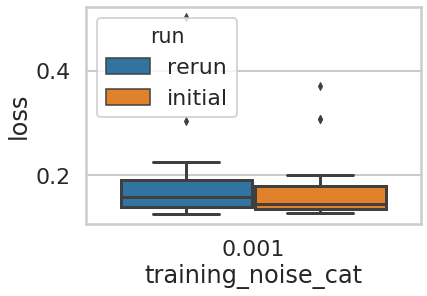

In [49]:
noise_0001['run'] = 'rerun'
init = uge_df[uge_df.training_noise == uge_df.noise_prob][uge_df.noise_prob == 0.001][uge_df.cost_err == uge_df.cost_inc][uge_df.mu_a == 0.5]
init['run'] = 'initial'
noise_0001 = noise_0001.append(init, ignore_index=True)
sns.boxplot('training_noise_cat', 'loss', data=noise_0001, hue='run')

In [50]:
un = rerun[rerun.cost_err != rerun.cost_inc][rerun.mu_a == 0.25][rerun.training_noise == rerun.noise_prob][rerun.noise_prob == 0.0]
un = un.append(uge_df[uge_df.sigma_a == 0.01][uge_df.training_noise == uge_df.noise_prob][uge_df.noise_prob == 0.0])

un.describe()

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.
c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


,P_err,P_inc,a_a,a_b,a_inc,b_a,b_b,b_inc,cost_err,cost_inc,loss,mu_a,noise_prob,sigma_a,training_noise,training_noise_cat,theta_0,theta_1,theta_2,theta_3,theta_4,theta_5,theta_6,theta_7,theta_8,theta_9,theta_10,theta_11,theta_12,theta_13
count,2.120000e+02,2.120000e+02,212.000000,2.120000e+02,2.120000e+02,2.120000e+02,212.000000,212.000000,212.000000,212.000000,212.000000,212.00,212.0,2.120000e+02,212.0,212.0,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000,212.000000
mean,1.767906e-02,1.704562e-01,0.935942,3.529983e-02,2.022663e-02,5.829172e-05,0.679173,0.320686,51.745283,10.471698,0.188135,0.25,0.0,1.000000e-02,0.0,0.0,5.863533,5.885379,6.172738,5.898362,6.599619,6.639105,6.834799,5.923615,6.128478,6.561526,6.045479,5.910479,6.437874,6.614739
std,1.327423e-02,2.475409e-01,0.007127,2.661874e-02,2.823306e-02,4.084568e-04,0.467792,0.467768,14.893659,6.216028,0.235474,0.00,0.0,1.738829e-18,0.0,0.0,3.651898,3.715156,3.573800,3.855726,3.489076,3.563360,3.458464,3.606104,3.828098,3.433879,3.449129,3.736763,3.641136,3.620588
min,-4.929872e-08,-1.515371e-08,0.867622,-1.383577e-08,-3.030741e-08,-9.904778e-08,0.000000,0.000000,25.000000,2.000000,0.009022,0.25,0.0,1.000000e-02,0.0,0.0,-0.022899,-0.495913,-0.001923,-0.486803,0.001234,-0.341491,-0.886634,-1.116649,-0.515488,0.254573,-0.433311,-1.056930,0.569753,0.105165
25%,1.261164e-05,3.269693e-07,0.937016,1.833115e-05,5.946026e-07,1.621083e-08,0.000000,0.000000,60.000000,10.000000,0.026718,0.25,0.0,1.000000e-02,0.0,0.0,3.120089,3.213147,3.143584,2.502390,3.743340,3.871469,4.163822,3.110654,2.229019,3.531014,3.567742,2.901110,3.578861,3.739134
50%,2.175008e-02,2.917439e-05,0.937313,4.349994e-02,4.200959e-05,2.581666e-07,1.000000,0.000000,60.000000,10.000000,0.031229,0.25,0.0,1.000000e-02,0.0,0.0,6.202783,6.001068,6.283198,5.800600,6.284459,6.051764,6.783327,5.638604,6.194211,6.573247,5.959872,6.148531,6.333838,6.813389
75%,3.059344e-02,5.282065e-01,0.937462,6.118545e-02,5.895390e-02,1.195469e-06,1.000000,0.999999,60.000000,10.000000,0.529288,0.25,0.0,1.000000e-02,0.0,0.0,9.174162,9.012424,9.424582,8.685789,9.424782,9.654777,9.667416,8.803715,9.501771,9.789875,8.778352,9.285460,9.565990,9.795134
max,3.149183e-02,5.313887e-01,0.937642,6.298358e-02,6.715467e-02,3.607468e-03,1.000000,1.000000,60.000000,20.000000,0.531460,0.25,0.0,1.000000e-02,0.0,0.0,12.970622,12.642476,12.571014,13.025566,12.566440,12.844267,12.269171,12.566400,12.906580,12.534317,13.173034,13.785316,13.607423,12.537213


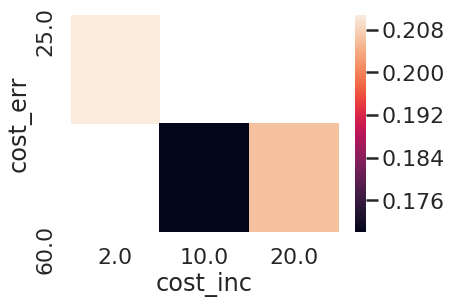

In [51]:
ung = un.groupby(['cost_err', 'cost_inc'], as_index=False)
m = ung.mean()
pi = m.pivot('cost_err', 'cost_inc', 'loss')
sns.heatmap(pi)

Success: 0.7863655352694605 \pm 0.017141460178947895
Success: 0.7884818573907251 \pm 0.017139299594493704
Success: 0.8255346486707575 \pm 0.010719642645404025


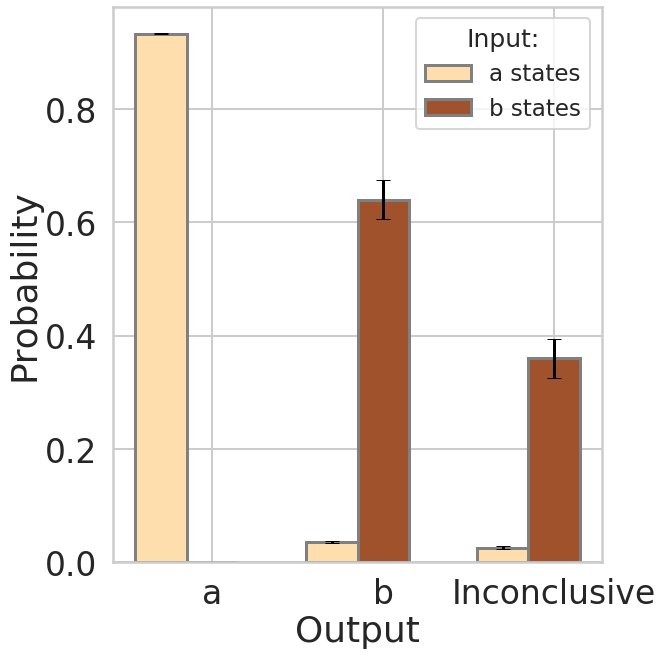

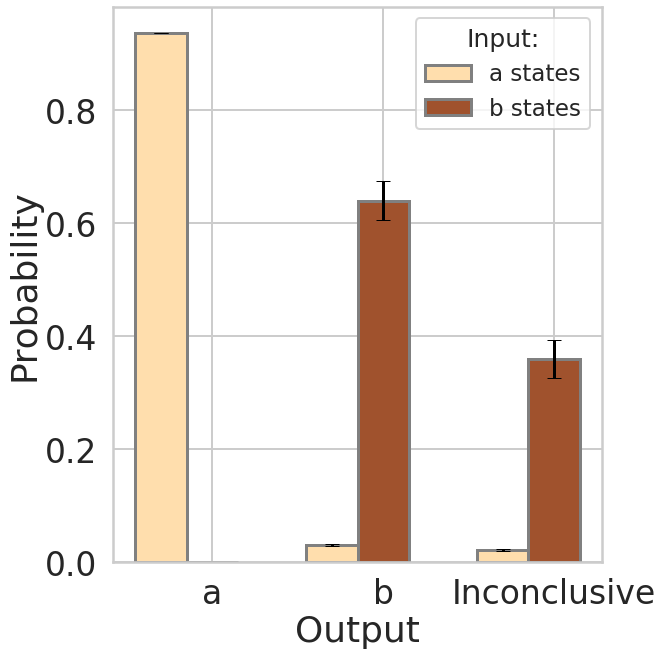

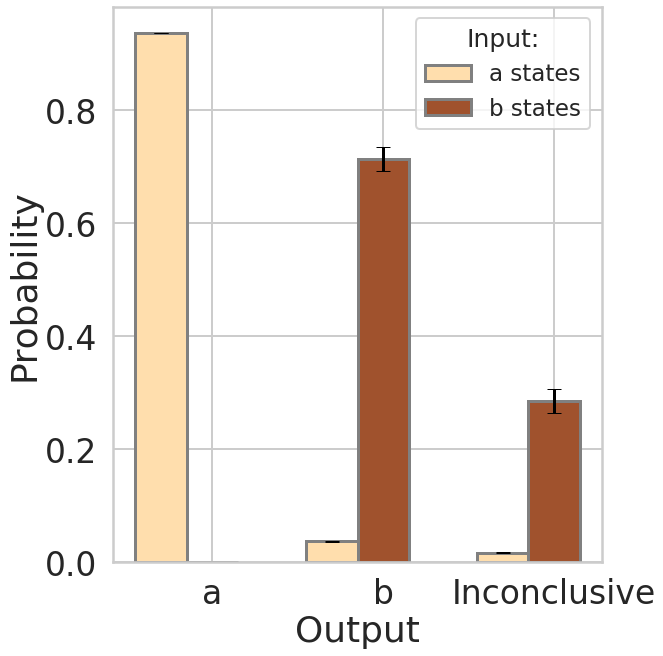

In [52]:
df_25_2 = un[un.cost_err == 25]
df_60_10 = un[un.cost_inc == 10]
df_60_20 = un[un.cost_inc == 20]
output_bar_plot(df_25_2)
output_bar_plot(df_60_20)
output_bar_plot(df_60_10, 'unambiguous.pdf')

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


Success: 0.7234215810894966 \pm 0.0007768950399322217
Success: 0.6266788393259048 \pm 0.012428127587543115
Success: 0.7019348576664924 \pm 0.004910477511955674


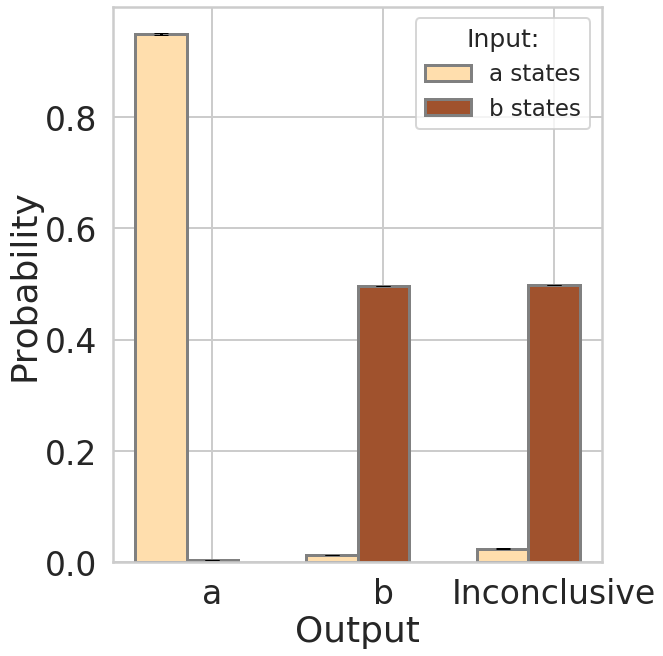

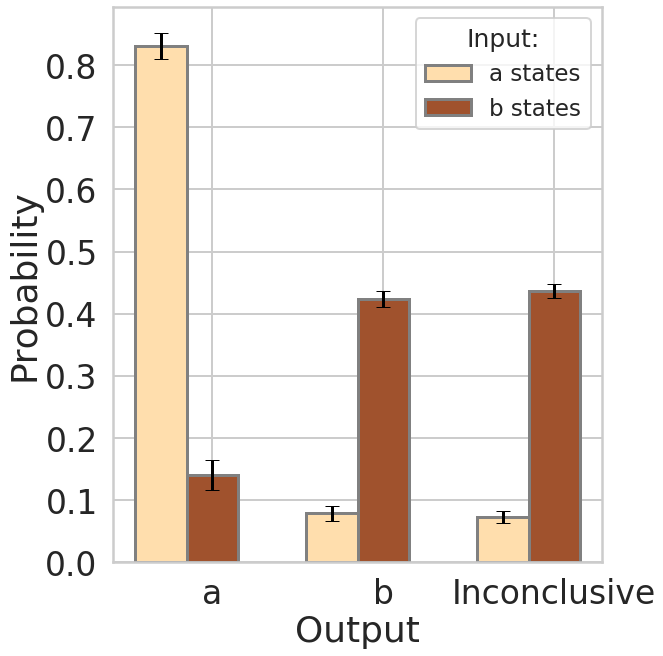

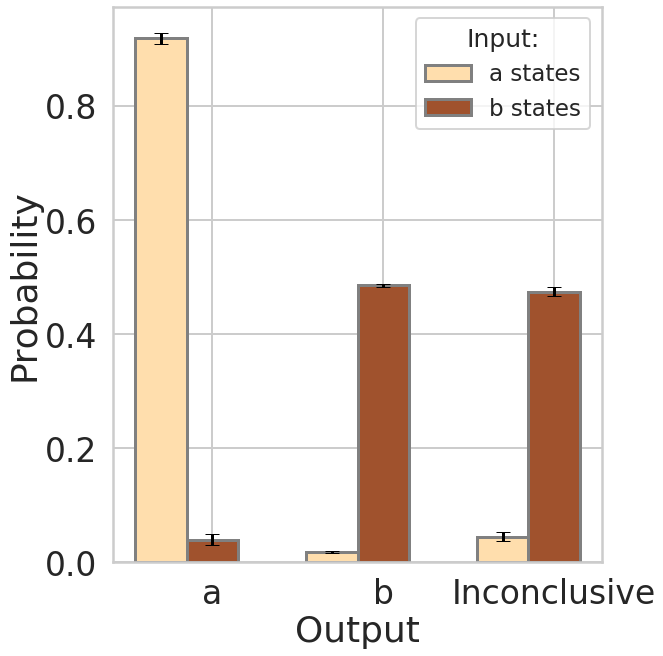

In [53]:
inc_old = uge_df_old[uge_df_old.sigma_a == 0.01][uge_df_old.training_noise == uge_df_old.noise_prob]
old_25_2 = inc_old[inc_old.cost_err == 25]
old_60_20 = inc_old[inc_old.cost_inc == 20]
old_60_10 = inc_old[inc_old.cost_inc == 10]
len(old_25_2.index)
output_bar_plot(old_25_2, 'unambiguous_long.pdf')
output_bar_plot(old_60_20)
output_bar_plot(old_60_10)

c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\ipykernel_launcher.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  This is separate from the ipykernel package so we can avoid doing imports until
c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\pandas\core\frame.py:7116: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort,
c:\users\andrew patterson\documents\phd\envs\ml_compiler\env\lib\site-packages\pandas\core\frame.py:7116: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=T

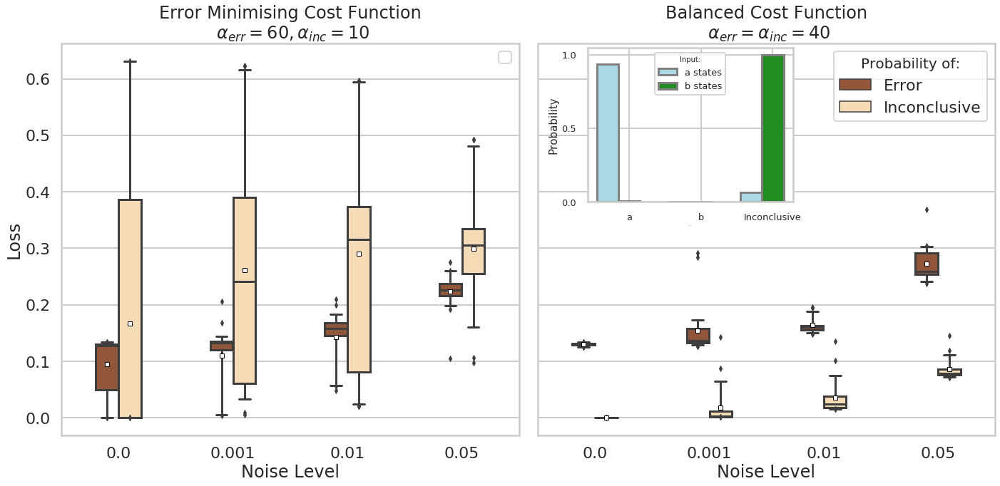

In [54]:
import matplotlib.image as mpimg
f, axs = plt.subplots(ncols=2, figsize=(20,10), sharey=True)
min_err = uge_df[uge_df.cost_err == 60][uge_df.cost_inc == 10][uge_df.mu_a == 0.5][uge_df.training_noise == uge_df.noise_prob]
c = copy.copy(min_err)
c = c.drop('P_err', axis=1)
c['P_err'] = c['P_inc']
c['spread'] = 'P_inc'
c = c[c.mu_a == 0.5]
for x in [0.0005, 0.005, 0.1]:
    c = c[c.noise_prob != x]
min_err['spread'] = 'P_err'
min_err_p  = min_err[min_err.mu_a == 0.5]
for x in [0.0005, 0.005, 0.1]:
    min_err_p = min_err_p[min_err_p.noise_prob != x]
pal = {'P_inc': 'navajowhite', 'P_err': 'sienna'}
concat= min_err_p.append(c, ignore_index=True)
min_e = sns.boxplot(x='training_noise_cat', y='P_err', hue='spread', palette=pal, data=concat, width=.4, ax=axs[0],  whis=[5,95], showmeans=True,  
                meanprops={'marker':'s', 'markerfacecolor':'white', 'markeredgecolor':'black'})


bal = copy.copy(balanced)
bal = bal[bal.mu_a == 0.5]
for x in [0.0005, 0.005, 0.1, 0.25, 0.5, 0.75]:
    bal = bal[bal.noise_prob != x]
b2 = copy.copy(bal)
b2 = b2[b2.mu_a == 0.5]
for x in [0.0005, 0.005, 0.1, 0.25, 0.5, 0.75]:
    b2 = b2[b2.noise_prob != x]
b2 = b2.drop('P_err', axis=1)
b2['P_err'] = b2['P_inc']
b2['spread'] = 'P_inc'
bal['spread'] = 'P_err'
c2 = bal.append(b2, ignore_index=True)
b = sns.boxplot(x='training_noise_cat', y='P_err', hue='spread', palette=pal, data=c2, width=.4, ax=axs[1],  whis=[5,95], showmeans=True,  
                meanprops={'marker':'s', 'markerfacecolor':'white', 'markeredgecolor':'black'})

text = ('Error', 'Inconclusive')

axs[0].set(xlabel='Noise Level', ylabel='Loss', title='Error Minimising Cost Function\n $\\alpha_{err} = 60, \\alpha_{inc} = 10$')
axs[0].legend((),())
# for t, l in zip(min_e.legend_.texts, text):
#     t.set_text(l)

axs[1].set(xlabel='Noise Level', ylabel='', title='Balanced Cost Function\n $\\alpha_{err} = \\alpha_{inc} = 40$')
# axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Probability of:')
axs[1].legend(title='Probability of:', title_fontsize=20, loc='upper right')
for t, l in zip(b.legend_.texts, text):
    t.set_text(l)
plt.tight_layout()

ax2 = f.add_axes([0.585, 0.58, 0.2, 0.3])
bar_width = 0.3
t1 = np.arange(len(probs[0]))
t2 = [x + bar_width for x in t1]
ax2.bar(t1, probs[0], width=bar_width, color='lightblue', capsize=7, label='a states', edgecolor='gray',linewidth=3)
ax2.bar(t2, probs[1], width=bar_width, color='forestgreen', capsize=7, label='b states', edgecolor='gray',linewidth=3)

plt.xticks([r + bar_width for r in range(len(t1))], ['a', 'b', 'Inconclusive'], size=13)
plt.yticks(size=13)
plt.ylabel('Probability', size=15)
plt.xlabel('Output', size=0)
plt.legend(title='Input:', title_fontsize=10, loc='upper center', fontsize=13)

plt.savefig(os.path.join(image_direc, 'min_err_dist_60_10.pdf'), bbox_inches='tight')